<a href="https://colab.research.google.com/github/Molzard/PCVK-Ganjil-2025/blob/main/PCVK_Kelompok_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Bagian A – Observasi & Eksperimen**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## **1. Tampilkan histogram tiap citra dan analisis distribusi intensitasnya.**

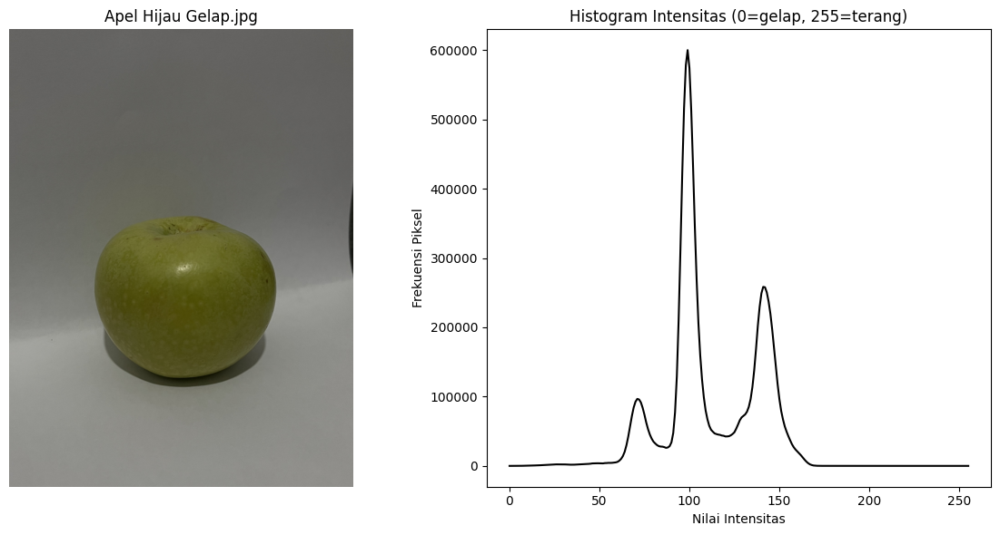

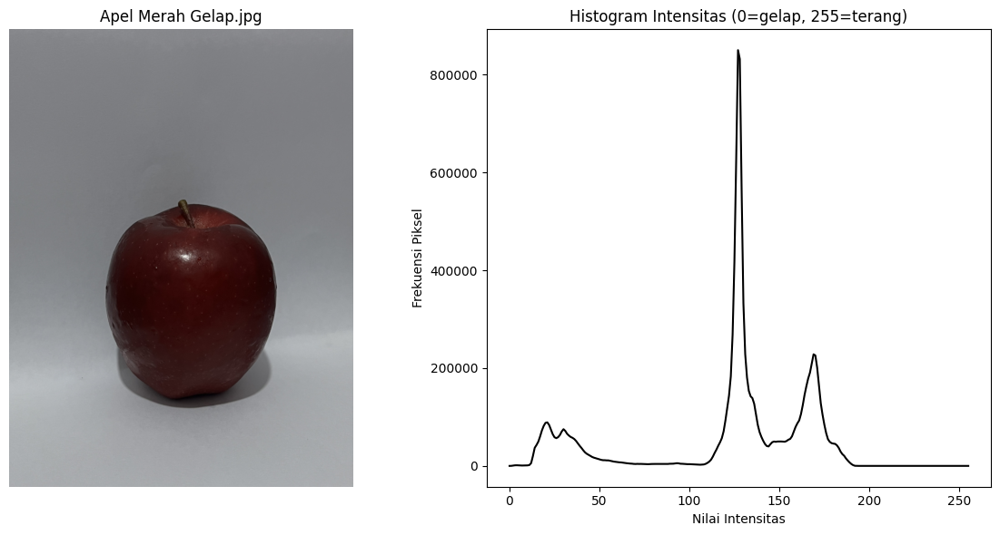

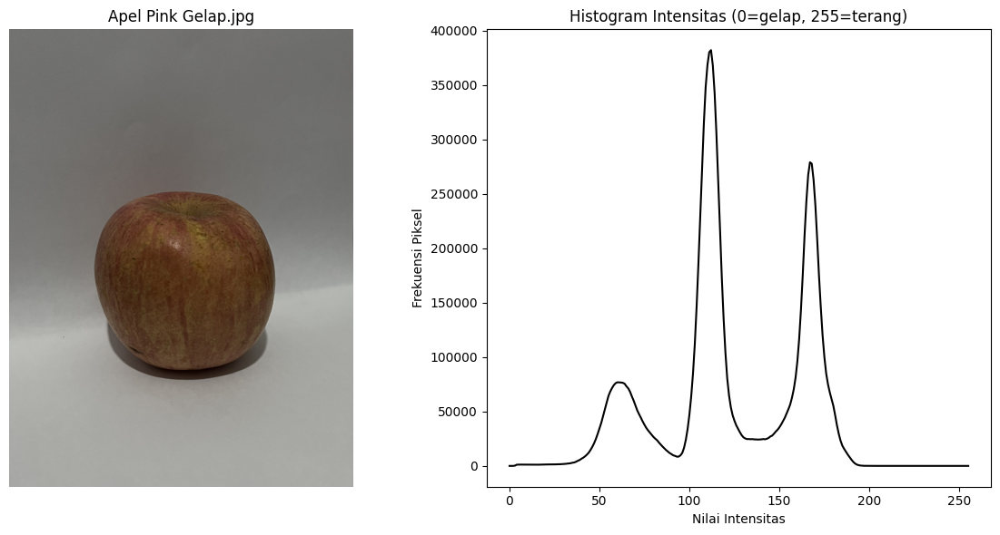

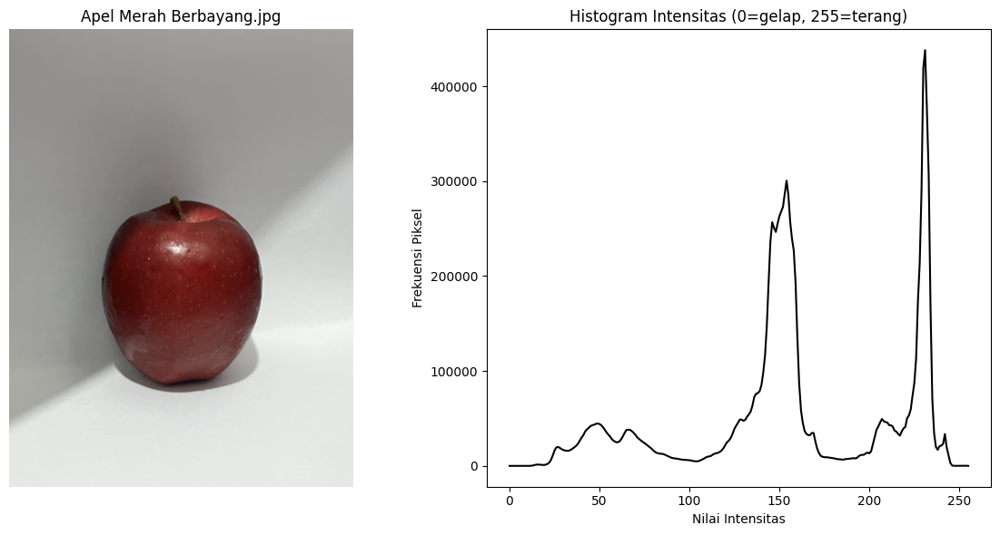

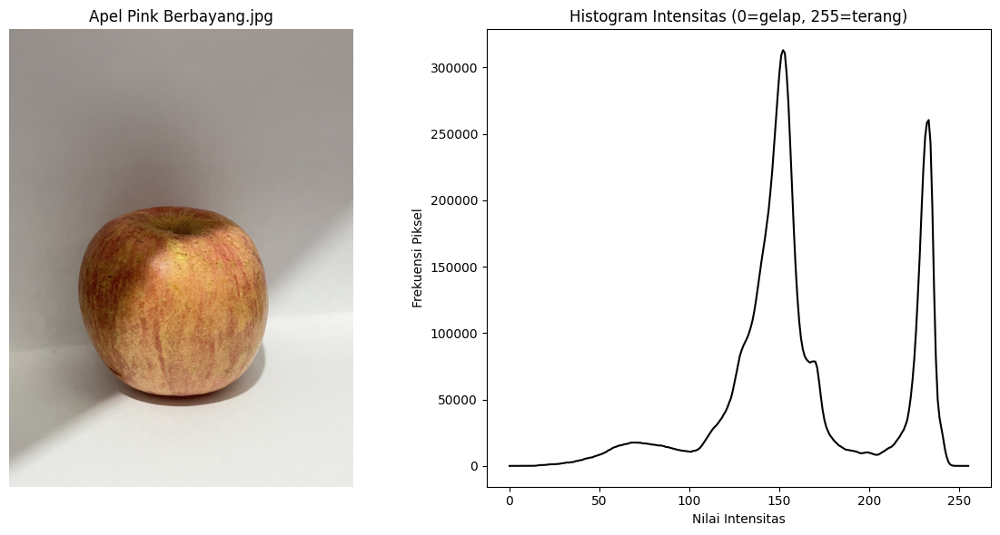

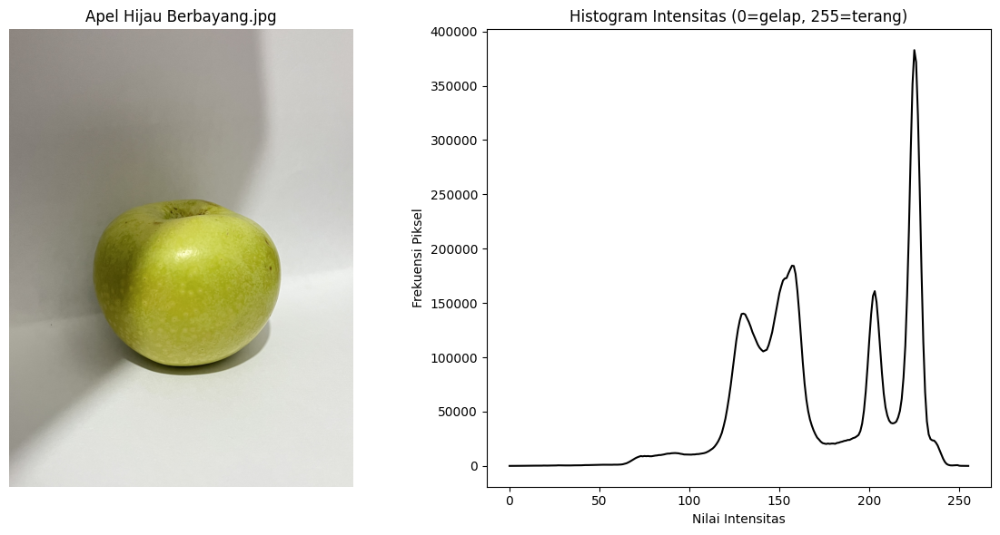

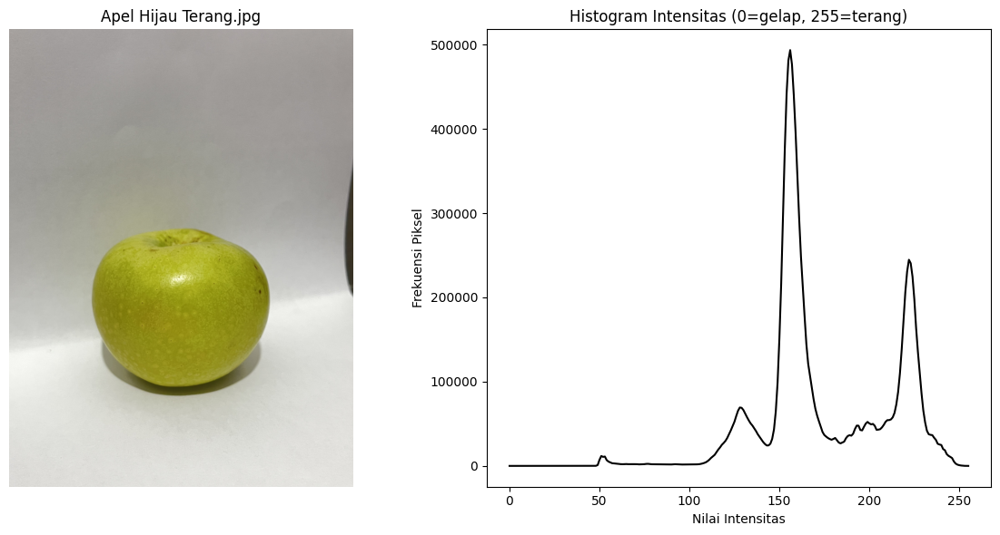

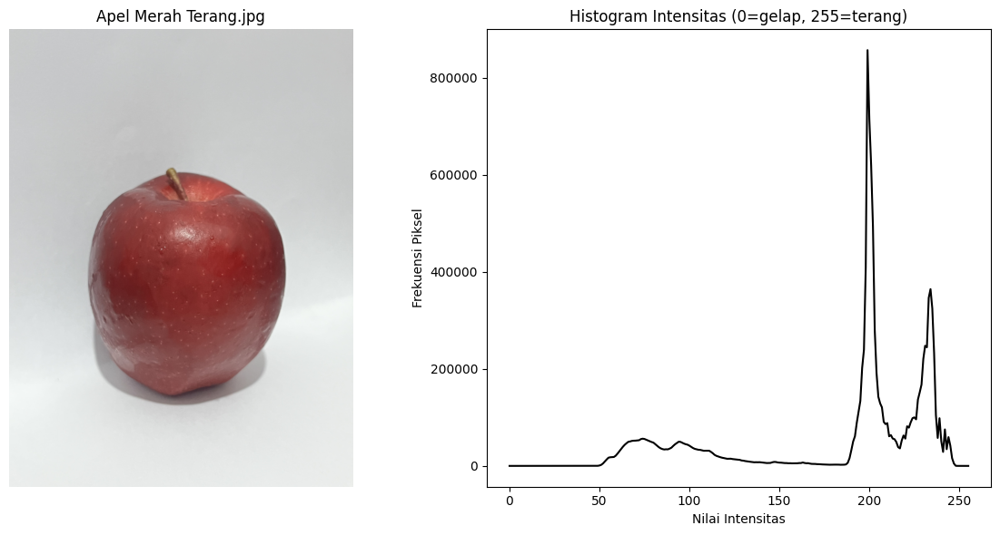

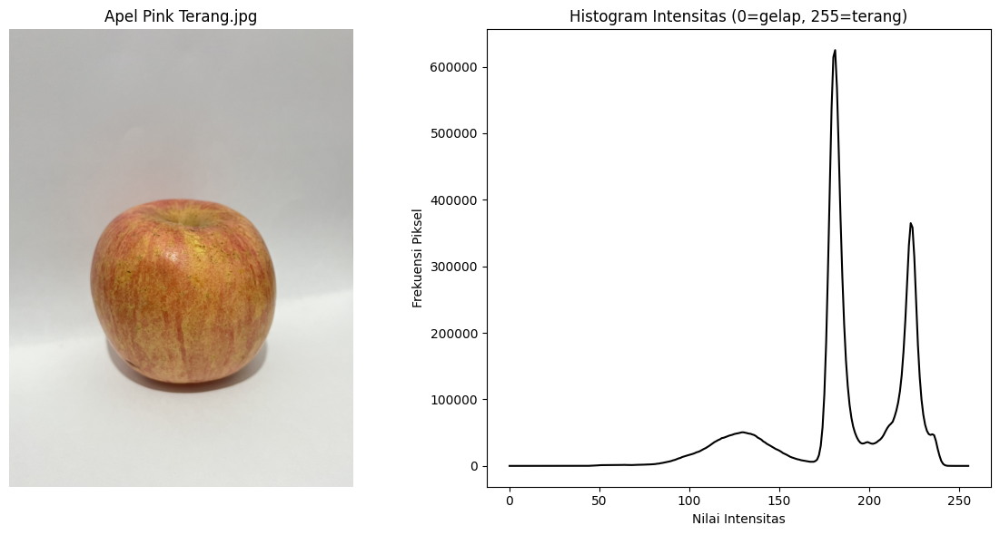

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os

# --- Path folder gambar (ubah sesuai lokasi kamu) ---
folder_path = '/content/drive/MyDrive/POLINEMA/PCVK_Kelompok'

# --- Hitung rata-rata kecerahan (brightness) ---
def mean_brightness(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    return np.mean(img)

# --- Fungsi menampilkan gambar & histogram ---
def show_histogram(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    hist = cv2.calcHist([gray], [0], None, [256], [0,256])

    plt.figure(figsize=(12,6))
    plt.subplot(1,2,1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(os.path.basename(image_path))
    plt.axis('off')

    plt.subplot(1,2,2)
    plt.plot(hist, color='black')
    plt.title('Histogram Intensitas (0=gelap, 255=terang)')
    plt.xlabel('Nilai Intensitas')
    plt.ylabel('Frekuensi Piksel')
    plt.tight_layout()
    plt.show()

# --- Ambil gambar & urutkan berdasarkan kecerahan ---
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg','.jpeg','.png'))]
image_files = sorted(image_files, key=lambda f: mean_brightness(os.path.join(folder_path, f)))

# --- Tampilkan hasil ---
for file in image_files:
    show_histogram(os.path.join(folder_path, file))


## **2. Terapkan transformasi brightness dan contrast (linear).**

- Tentukan nilai b (brightness) dan a (contrast) yang sesuai.

/tmp/ipython-input-3652787102.py:41: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(gray_asli.ravel(), 256, [0,256], color='gray', label='Asli', alpha=0.6)
/tmp/ipython-input-3652787102.py:42: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(gray_bc.ravel(), 256, [0,256], color='blue', label='Setelah BC', alpha=0.6)


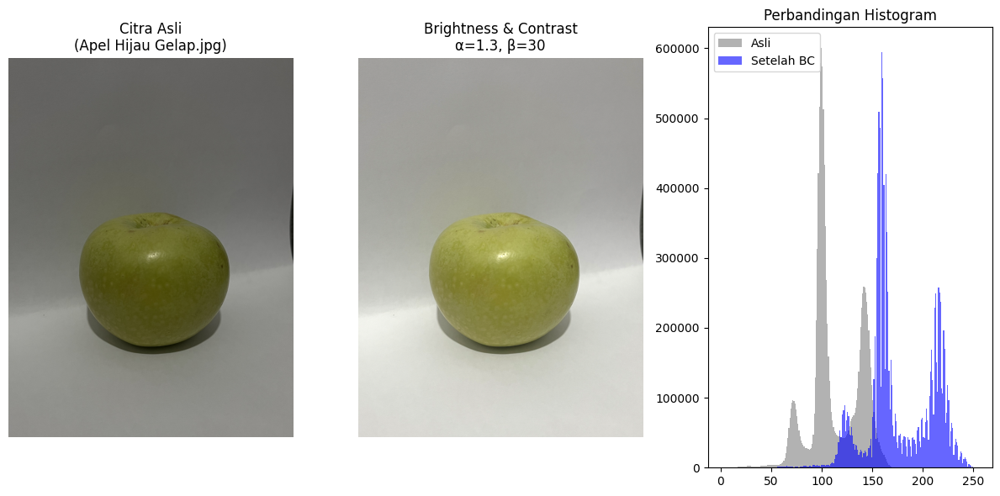

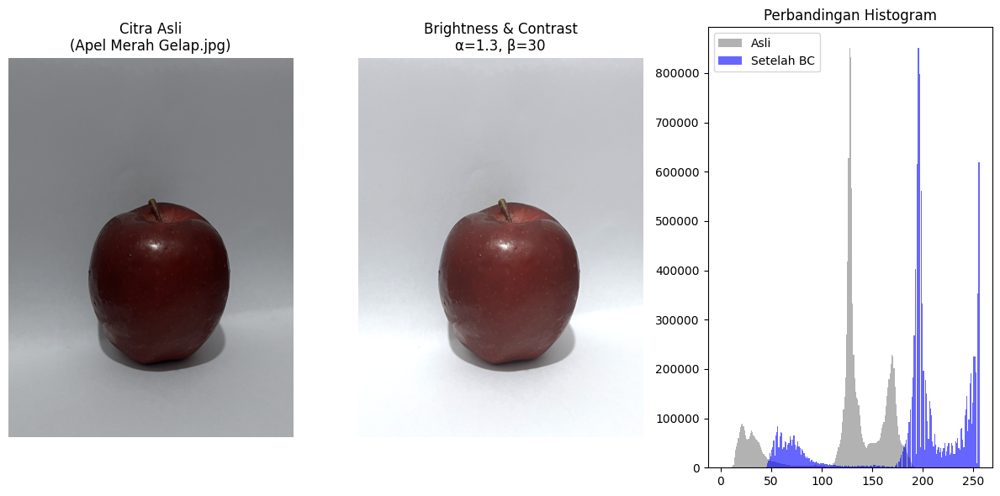

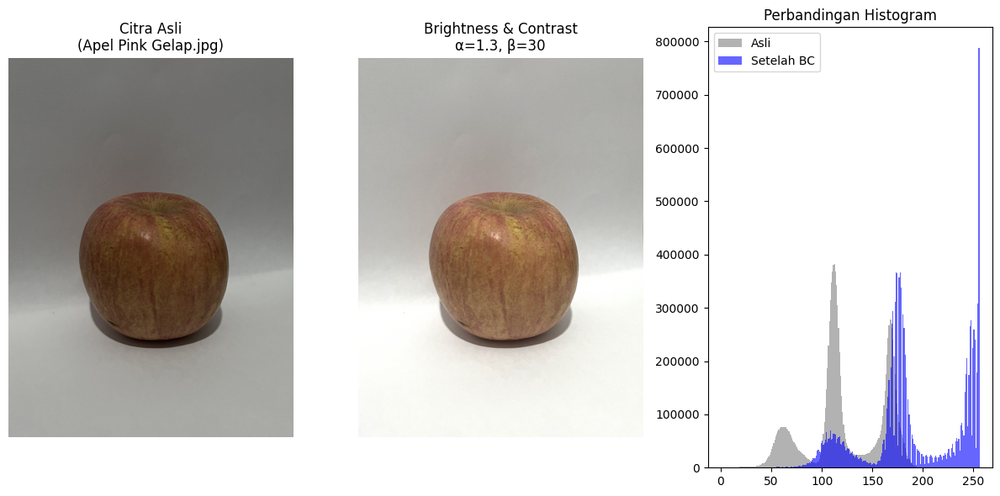

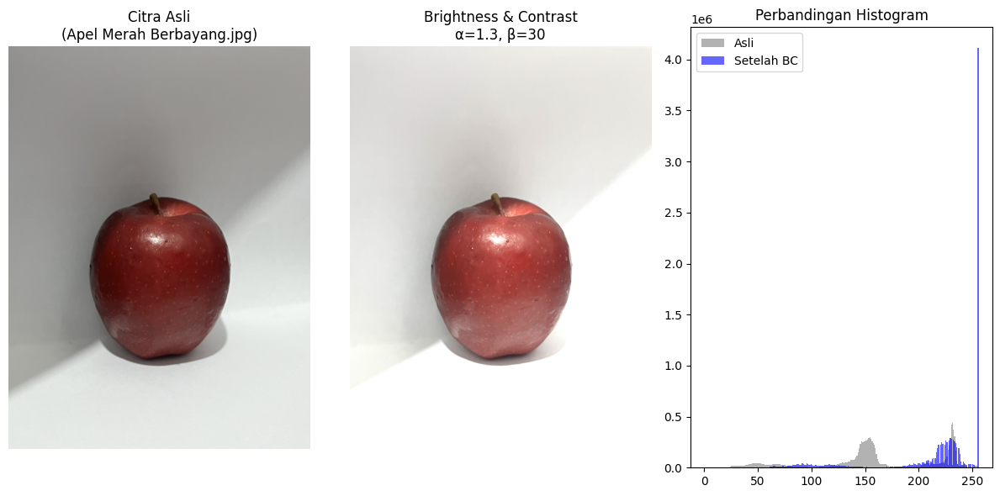

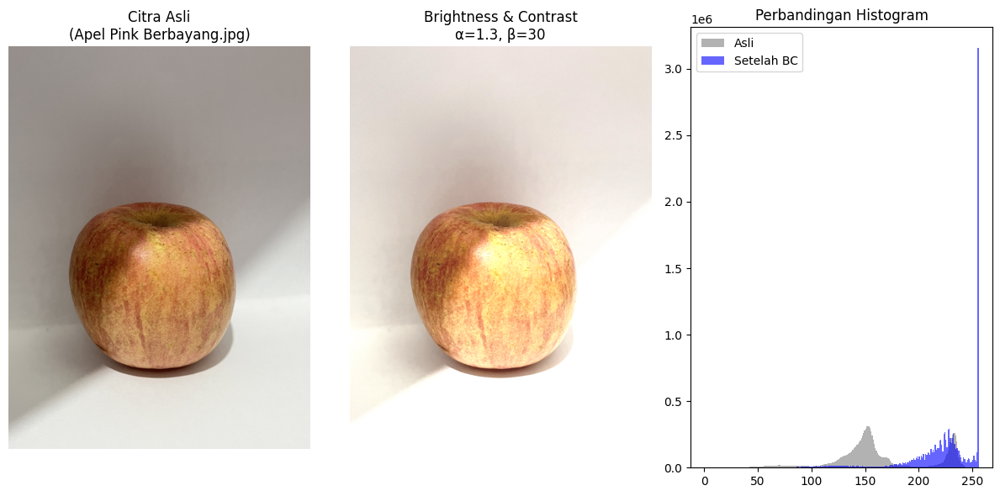

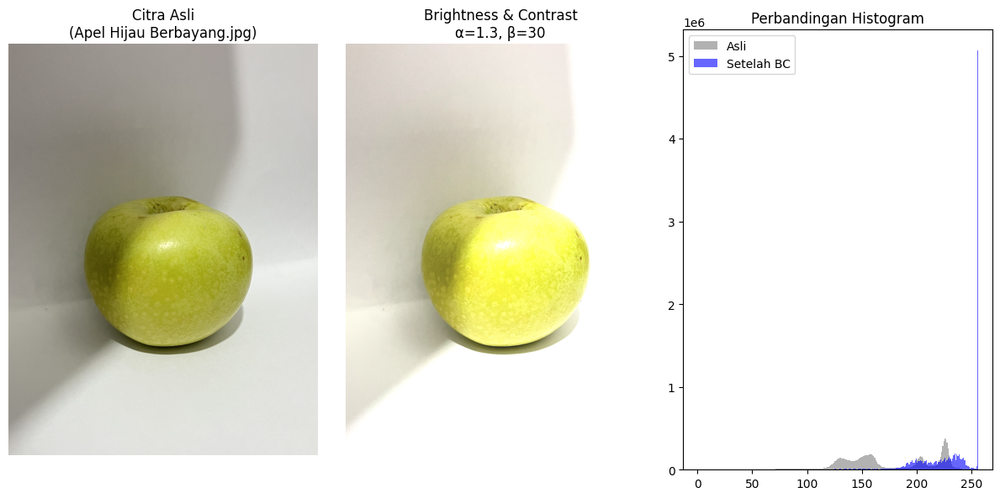

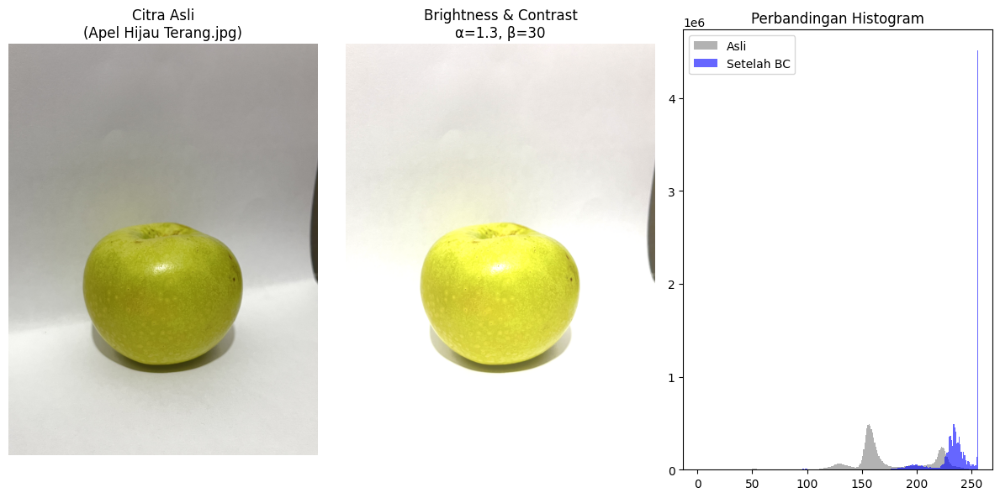

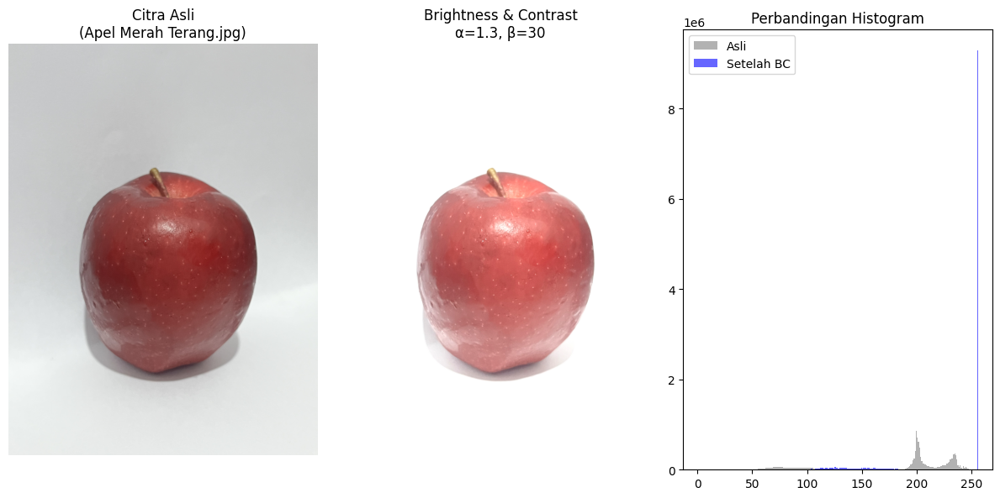

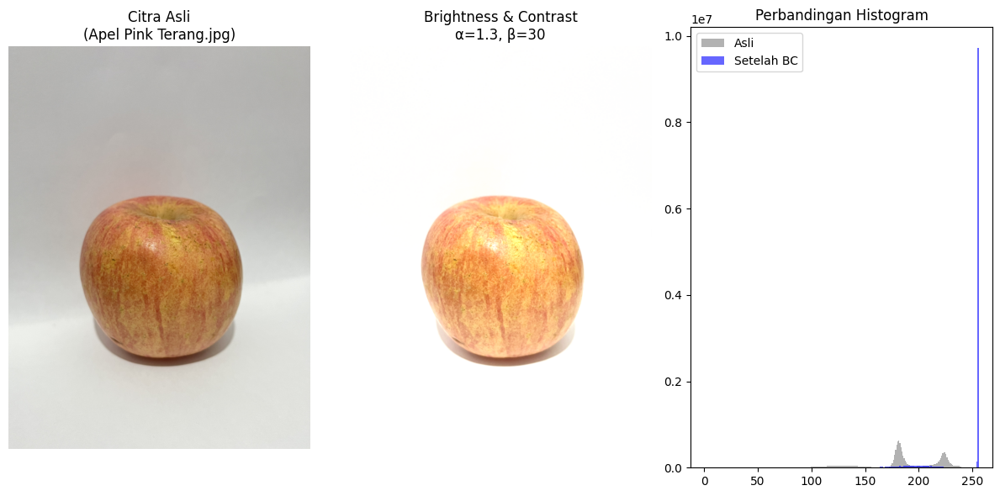

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os

# --- Parameter BC ---
alpha = 1.3   # kontras
beta = 30     # brightness

folder_path = '/content/drive/MyDrive/POLINEMA/PCVK_Kelompok'

# --- Fungsi menyesuaikan brightness & contrast ---
def adjust_brightness_contrast(image, alpha, beta):
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

# --- Fungsi menghitung kecerahan rata-rata ---
def mean_brightness(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    return np.mean(img)

# --- Fungsi menampilkan hasil BC & histogram ---
def show_bc(image_path, alpha, beta):
    img = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_bc = adjust_brightness_contrast(img_rgb, alpha, beta)

    plt.figure(figsize=(12,6))

    # Citra Asli
    plt.subplot(1,3,1)
    plt.imshow(img_rgb)
    plt.title(f'Citra Asli\n({os.path.basename(image_path)})')
    plt.axis('off')

    # Citra Setelah BC
    plt.subplot(1,3,2)
    plt.imshow(img_bc)
    plt.title(f'Brightness & Contrast\nα={alpha}, β={beta}')
    plt.axis('off')

    # Histogram Perbandingan
    gray_asli = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
    gray_bc = cv2.cvtColor(img_bc, cv2.COLOR_RGB2GRAY)
    plt.subplot(1,3,3)
    plt.hist(gray_asli.ravel(), 256, [0,256], color='gray', label='Asli', alpha=0.6)
    plt.hist(gray_bc.ravel(), 256, [0,256], color='blue', label='Setelah BC', alpha=0.6)
    plt.legend()
    plt.title('Perbandingan Histogram')
    plt.tight_layout()
    plt.show()
    plt.pause(0.3)

# --- Ambil & urutkan gambar berdasarkan kecerahan ---
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg','.jpeg','.png'))]
image_files = sorted(image_files, key=lambda f: mean_brightness(os.path.join(folder_path, f)))

# --- Jalankan untuk semua gambar ---
for file in image_files:
    full_path = os.path.join(folder_path, file)
    show_bc(full_path, alpha, beta)


## **3. Lakukan histogram equalization untuk memperbaiki sebaran kontras.**

- Bandingkan hasil visual dan histogram sebelum–sesudah.

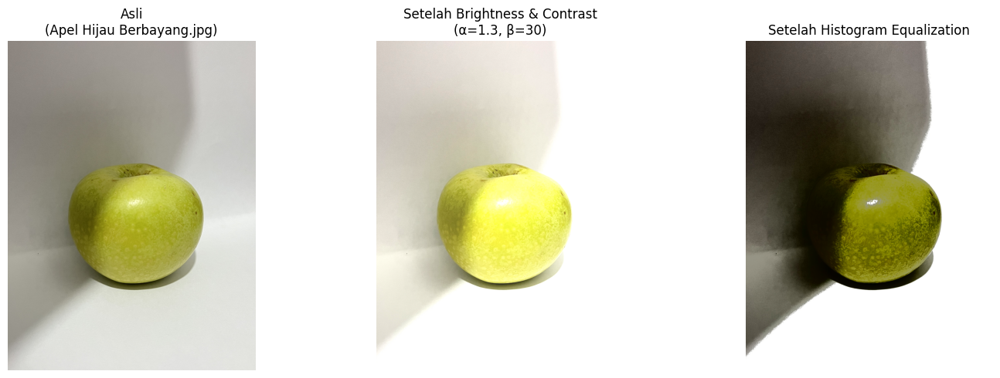

/tmp/ipython-input-3078455591.py:63: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(img_bc[:,:,i].ravel(), 256, [0,256], color=col)
/tmp/ipython-input-3078455591.py:70: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(img_eq[:,:,i].ravel(), 256, [0,256], color=col)


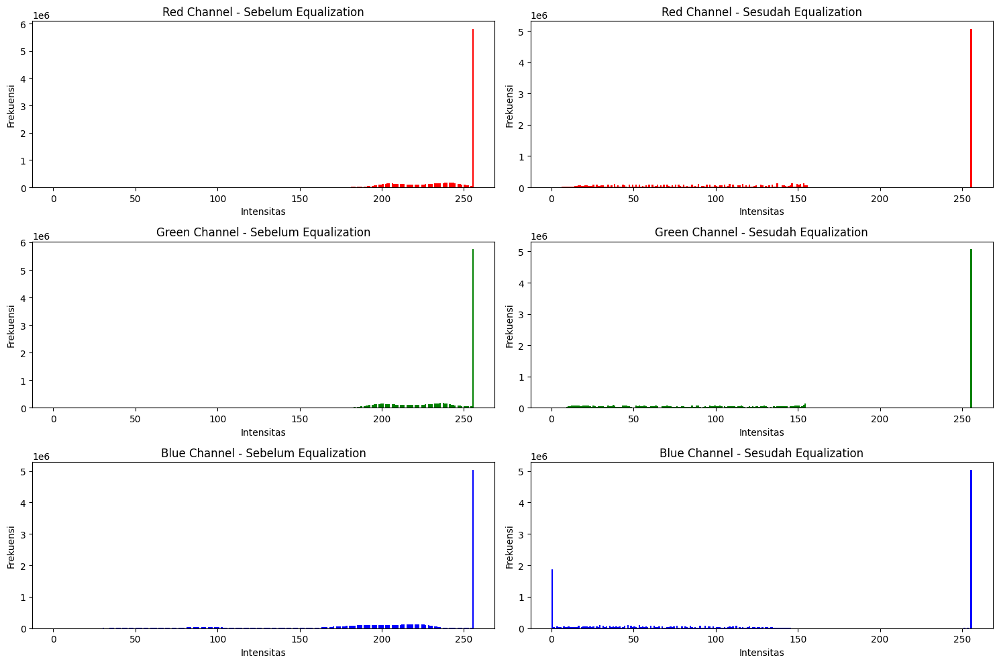

🔹 Apel Hijau Berbayang.jpg
   Rata-rata brightness:
   - Asli        : 173.82
   - Setelah BC  : 230.97
   - Setelah HE  : 150.95
   📊 Setelah equalization, distribusi warna di tiap channel (R, G, B) menjadi lebih seimbang dan tidak terlalu menumpuk pada area gelap atau terang.



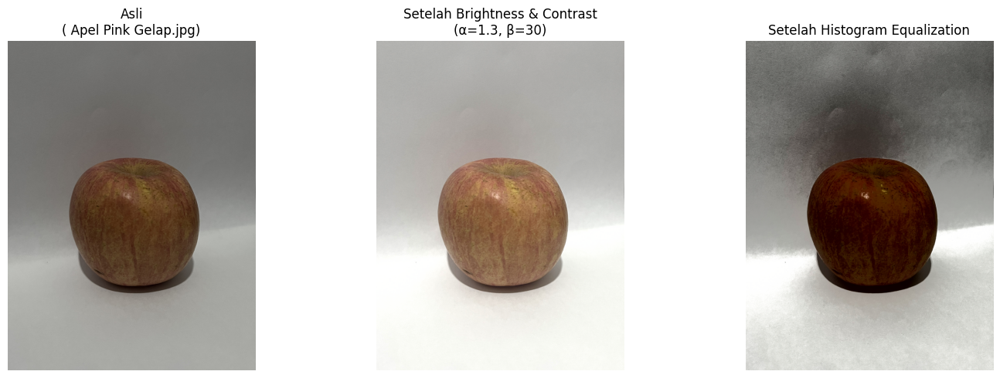

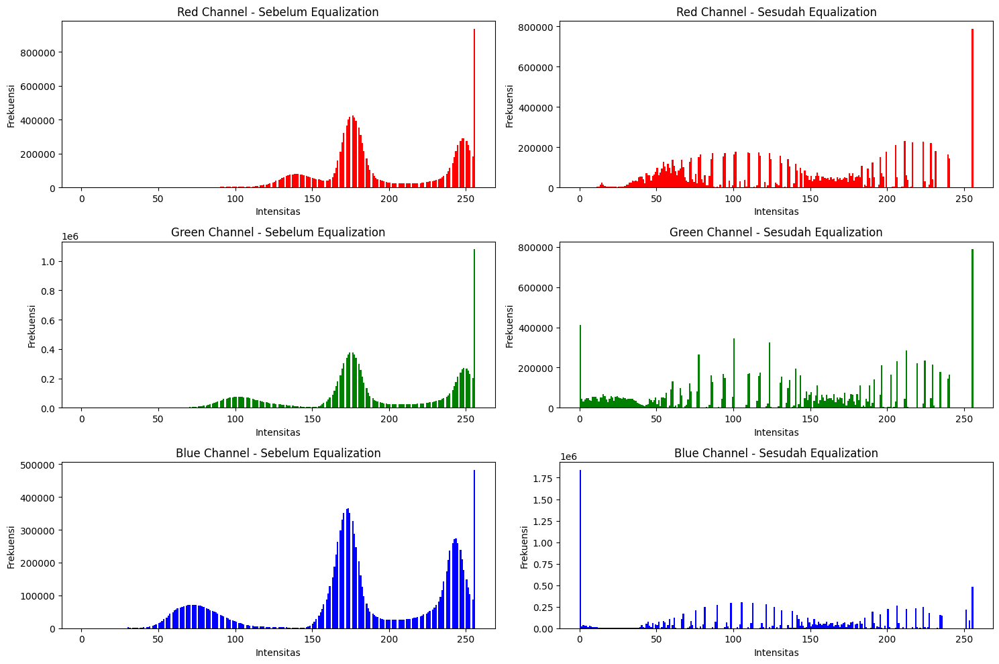

🔹  Apel Pink Gelap.jpg
   Rata-rata brightness:
   - Asli        : 123.48
   - Setelah BC  : 190.10
   - Setelah HE  : 130.13
   📊 Setelah equalization, distribusi warna di tiap channel (R, G, B) menjadi lebih seimbang dan tidak terlalu menumpuk pada area gelap atau terang.



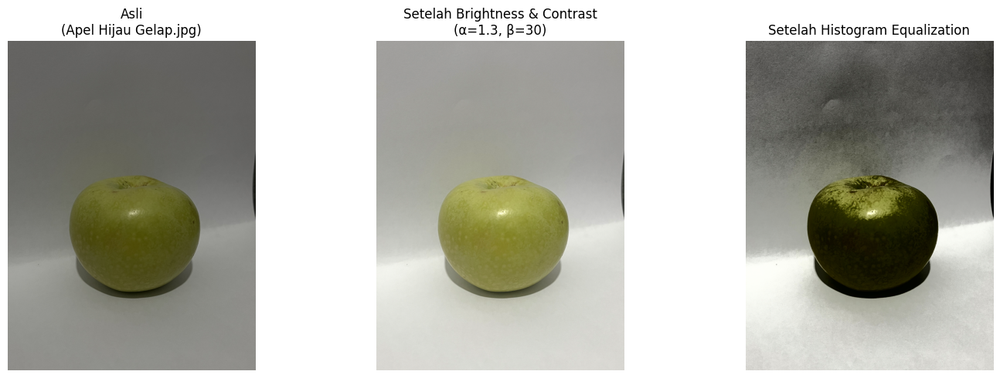

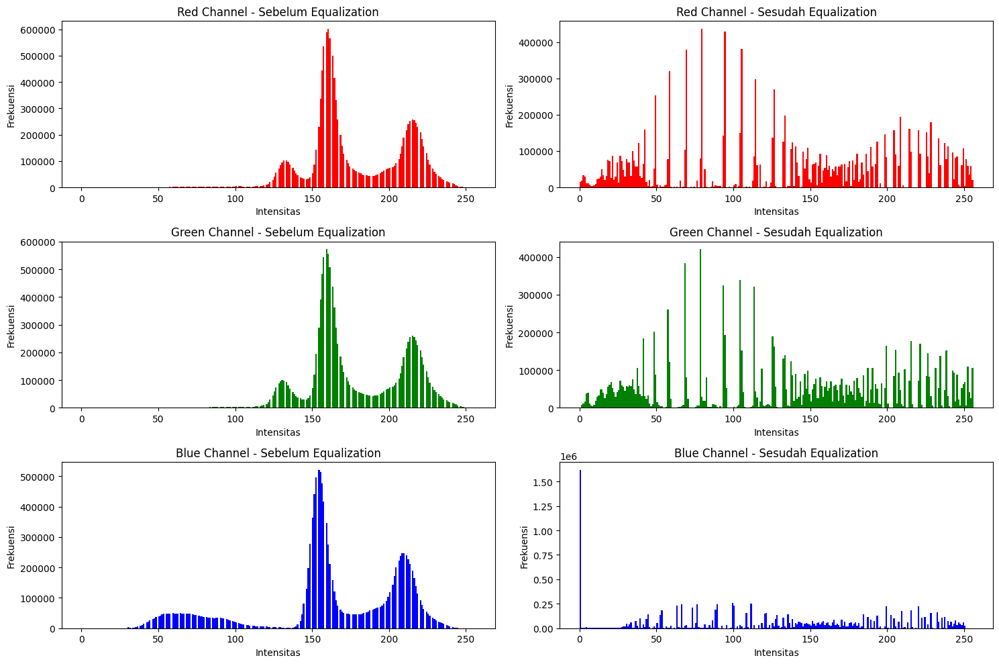

🔹 Apel Hijau Gelap.jpg
   Rata-rata brightness:
   - Asli        : 111.92
   - Setelah BC  : 175.56
   - Setelah HE  : 130.55
   📊 Setelah equalization, distribusi warna di tiap channel (R, G, B) menjadi lebih seimbang dan tidak terlalu menumpuk pada area gelap atau terang.



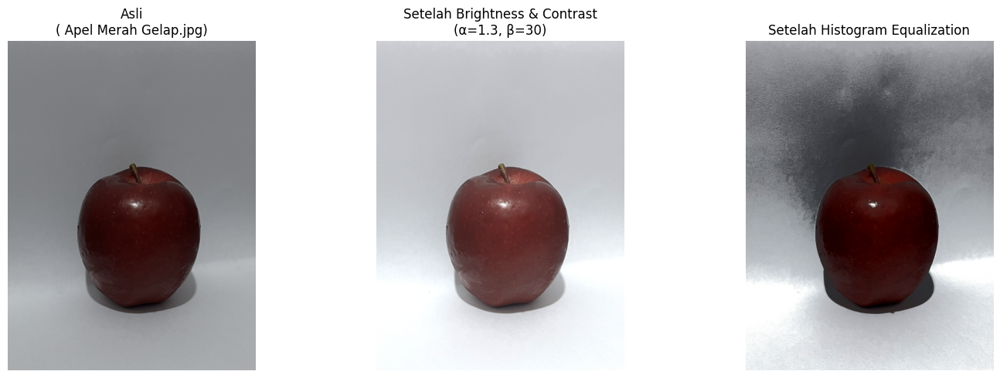

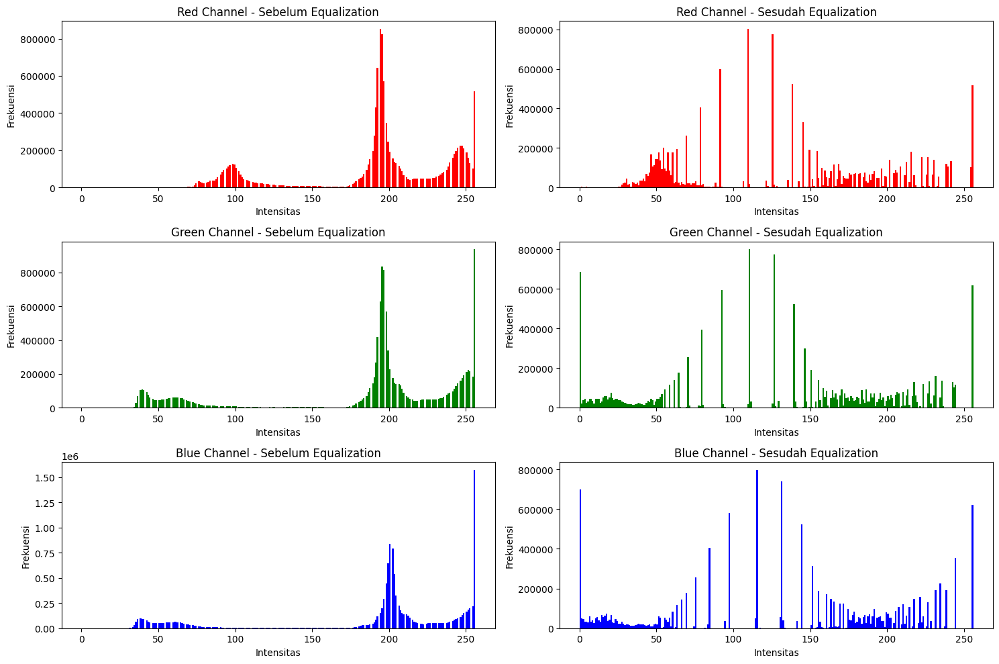

🔹  Apel Merah Gelap.jpg
   Rata-rata brightness:
   - Asli        : 122.74
   - Setelah BC  : 189.12
   - Setelah HE  : 130.85
   📊 Setelah equalization, distribusi warna di tiap channel (R, G, B) menjadi lebih seimbang dan tidak terlalu menumpuk pada area gelap atau terang.



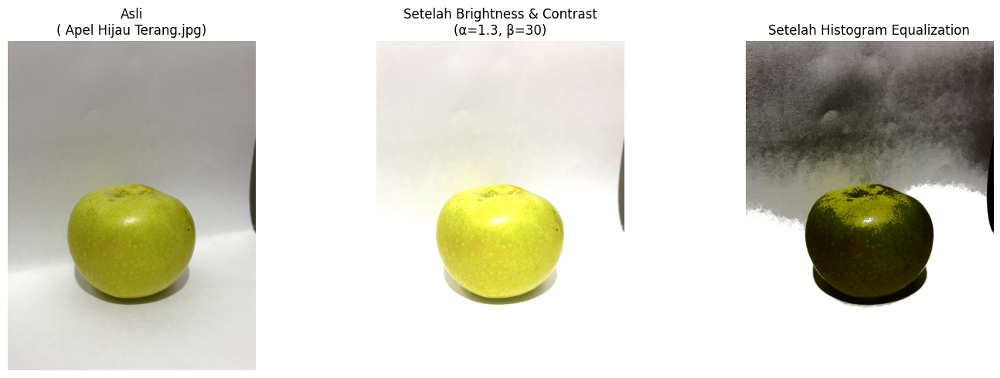

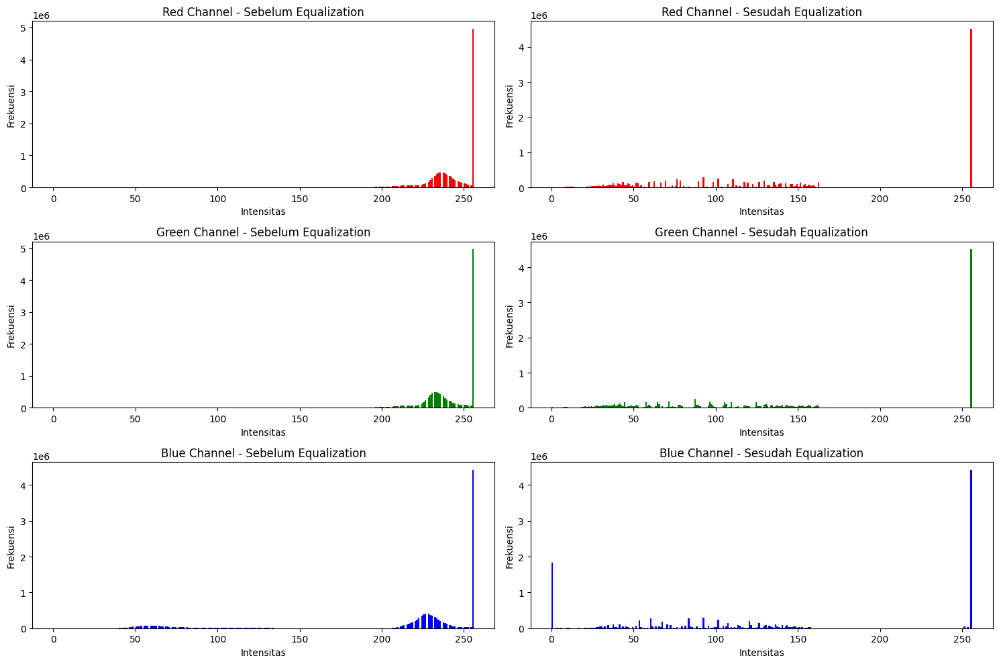

🔹  Apel Hijau Terang.jpg
   Rata-rata brightness:
   - Asli        : 175.10
   - Setelah BC  : 237.05
   - Setelah HE  : 148.12
   📊 Setelah equalization, distribusi warna di tiap channel (R, G, B) menjadi lebih seimbang dan tidak terlalu menumpuk pada area gelap atau terang.



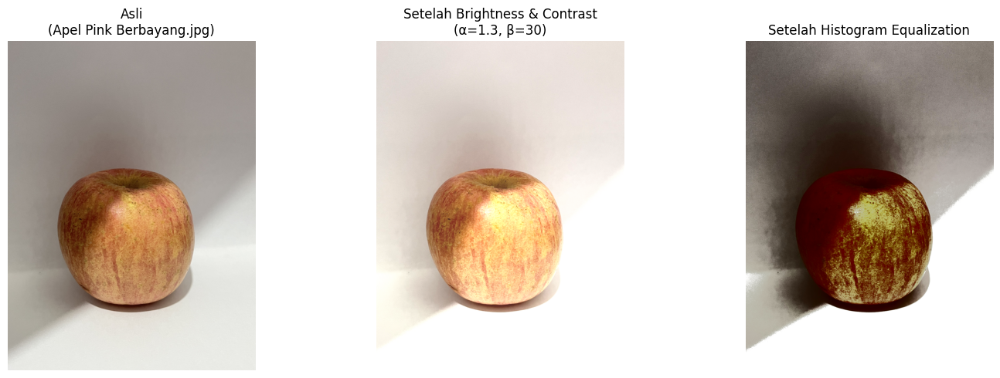

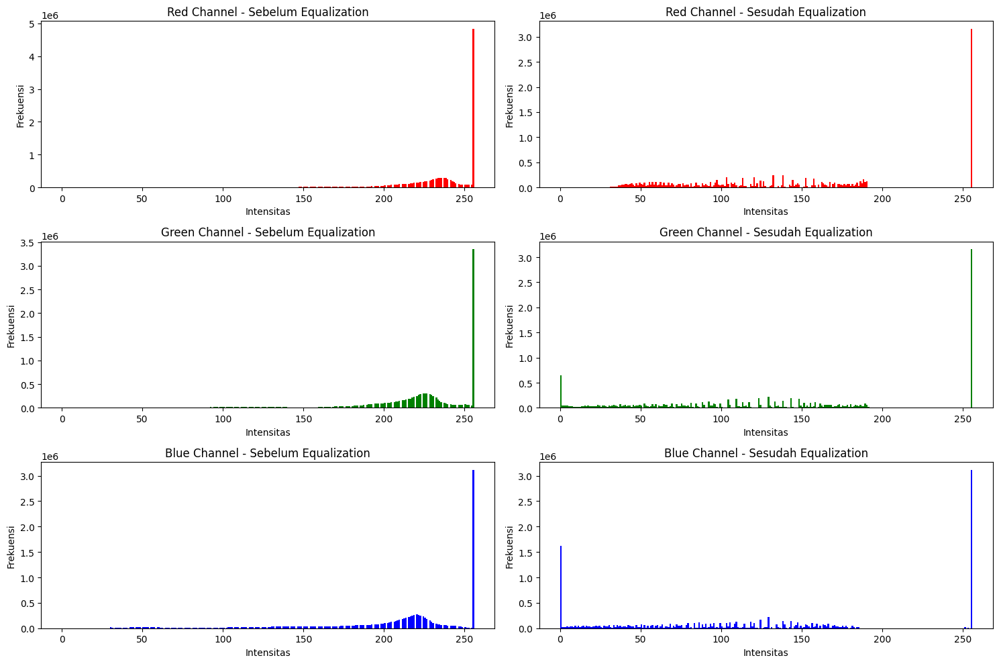

🔹 Apel Pink Berbayang.jpg
   Rata-rata brightness:
   - Asli        : 162.56
   - Setelah BC  : 222.18
   - Setelah HE  : 137.88
   📊 Setelah equalization, distribusi warna di tiap channel (R, G, B) menjadi lebih seimbang dan tidak terlalu menumpuk pada area gelap atau terang.



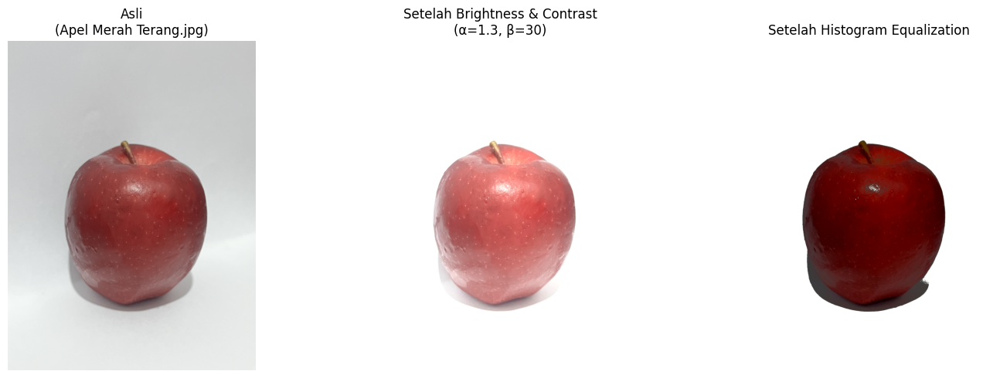

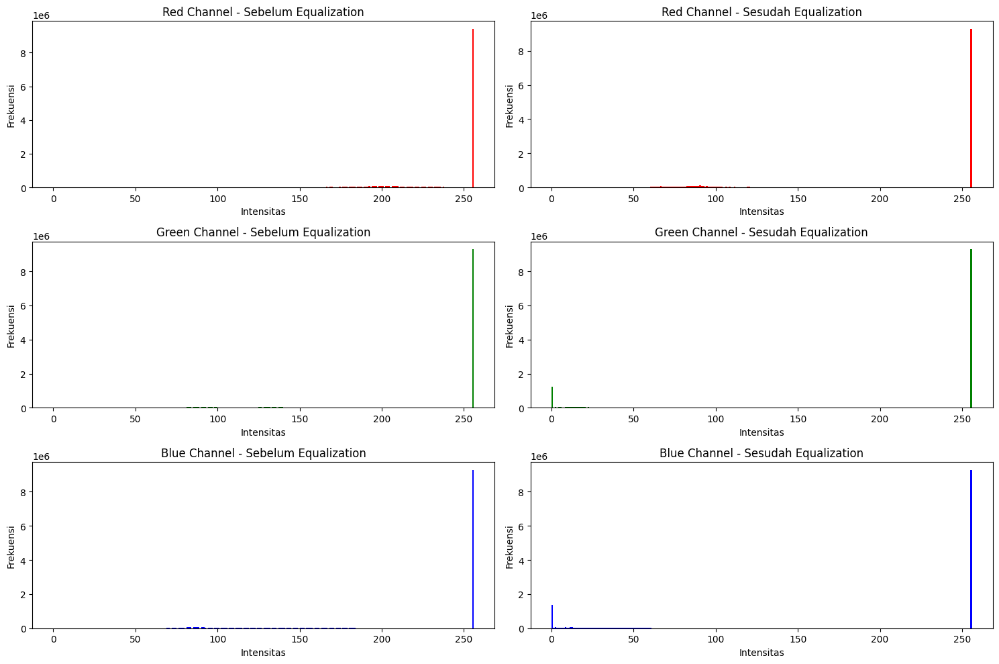

🔹 Apel Merah Terang.jpg
   Rata-rata brightness:
   - Asli        : 184.58
   - Setelah BC  : 230.11
   - Setelah HE  : 202.69
   📊 Setelah equalization, distribusi warna di tiap channel (R, G, B) menjadi lebih seimbang dan tidak terlalu menumpuk pada area gelap atau terang.



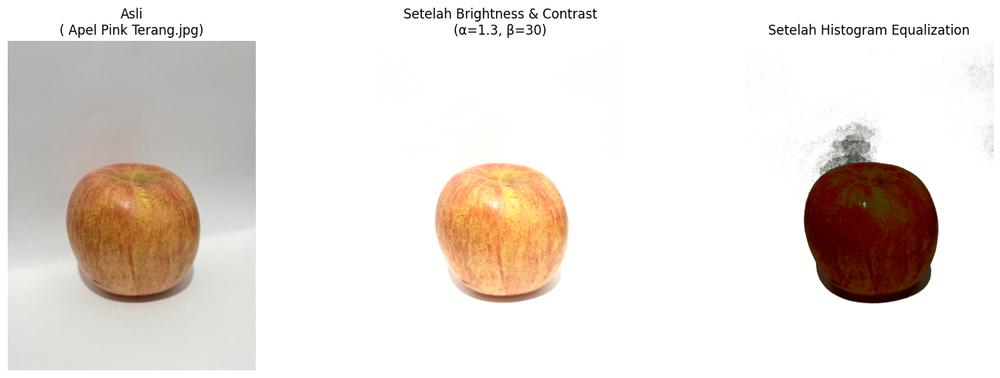

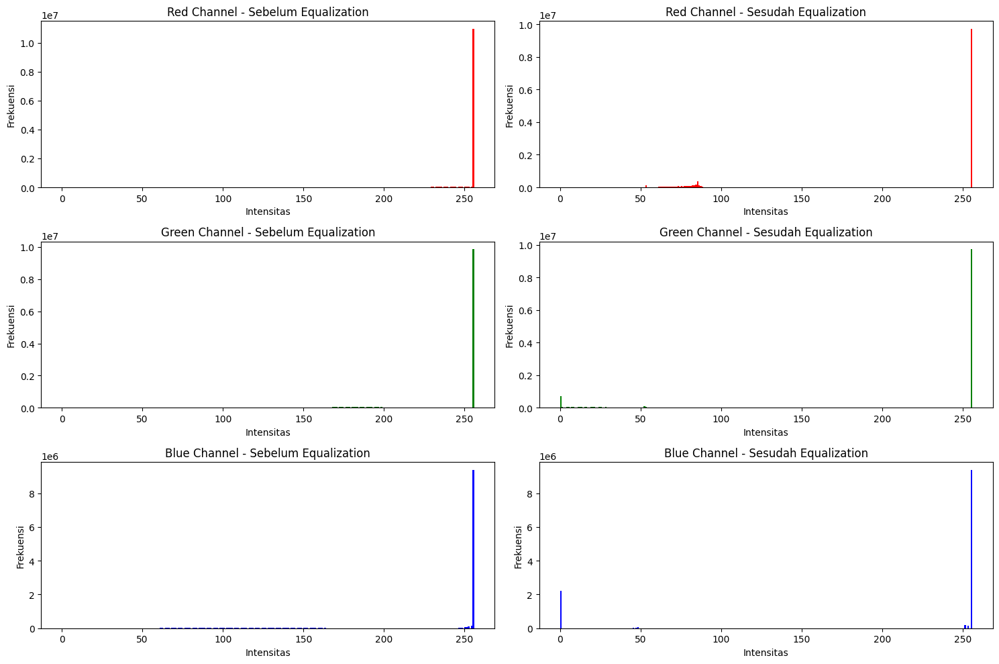

🔹  Apel Pink Terang.jpg
   Rata-rata brightness:
   - Asli        : 185.51
   - Setelah BC  : 243.01
   - Setelah HE  : 209.94
   📊 Setelah equalization, distribusi warna di tiap channel (R, G, B) menjadi lebih seimbang dan tidak terlalu menumpuk pada area gelap atau terang.



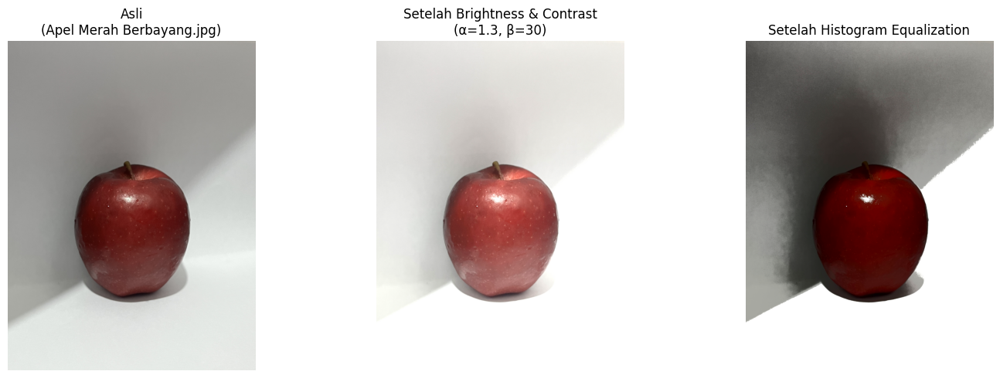

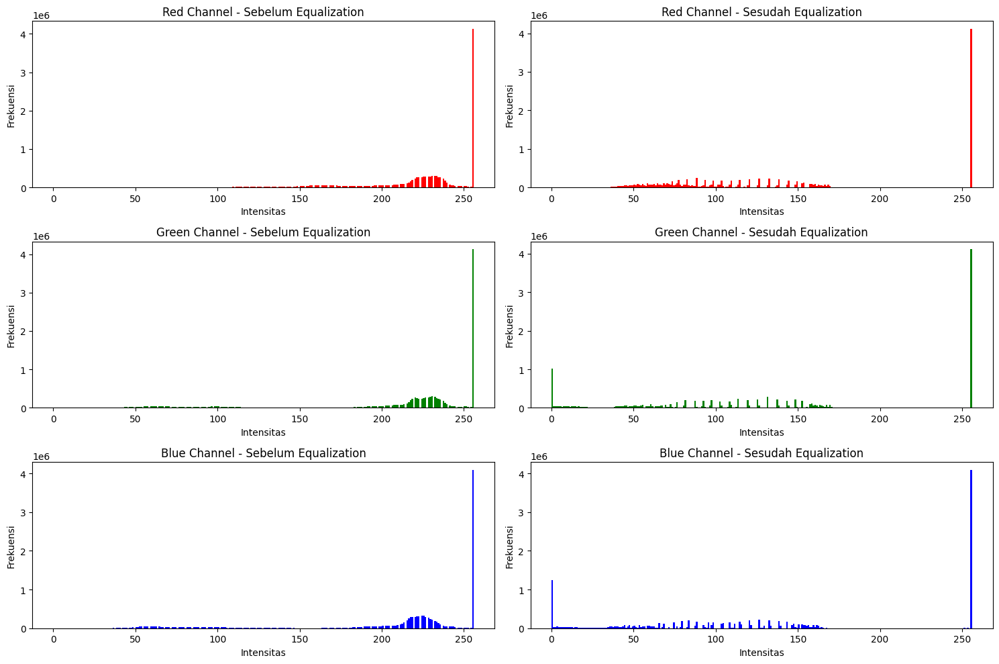

🔹 Apel Merah Berbayang.jpg
   Rata-rata brightness:
   - Asli        : 159.79
   - Setelah BC  : 215.31
   - Setelah HE  : 143.75
   📊 Setelah equalization, distribusi warna di tiap channel (R, G, B) menjadi lebih seimbang dan tidak terlalu menumpuk pada area gelap atau terang.



In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os

folder_path = '/content/drive/MyDrive/POLINEMA/PCVK_Kelompok'

# --- Fungsi untuk menyesuaikan brightness & contrast ---
def adjust_brightness_contrast(image, alpha, beta):
    # alpha = kontras, beta = brightness
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

# --- Fungsi Histogram Equalization untuk citra RGB ---
def hist_equalization_rgb(img_rgb):
    # Konversi ke YCrCb agar hanya channel luminance (Y) yang diubah
    img_ycrcb = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2YCrCb)
    y, cr, cb = cv2.split(img_ycrcb)
    y_eq = cv2.equalizeHist(y)
    img_ycrcb_eq = cv2.merge([y_eq, cr, cb])
    img_eq_rgb = cv2.cvtColor(img_ycrcb_eq, cv2.COLOR_YCrCb2RGB)
    return img_eq_rgb

# --- Fungsi utama untuk menampilkan perbandingan ---
def show_bc_he(image_path, alpha, beta):
    img_bgr = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    # 1️⃣ Brightness & Contrast
    img_bc = adjust_brightness_contrast(img_rgb, alpha, beta)

    # 2️⃣ Histogram Equalization
    img_eq = hist_equalization_rgb(img_bc)

    # --- Visualisasi gambar ---
    plt.figure(figsize=(15,5))
    plt.subplot(1,3,1)
    plt.imshow(img_rgb)
    plt.title(f'Asli\n({os.path.basename(image_path)})')
    plt.axis('off')

    plt.subplot(1,3,2)
    plt.imshow(img_bc)
    plt.title(f'Setelah Brightness & Contrast\n(α={alpha}, β={beta})')
    plt.axis('off')

    plt.subplot(1,3,3)
    plt.imshow(img_eq)
    plt.title('Setelah Histogram Equalization')
    plt.axis('off')
    plt.tight_layout()
    plt.show()



    # --- Histogram RGB (dipisahkan per channel) ---
    colors = ('r', 'g', 'b')
    labels = ('Red', 'Green', 'Blue')

    plt.figure(figsize=(15,10))
    for i, (col, label) in enumerate(zip(colors, labels)):
        # Sebelum equalization
        plt.subplot(3, 2, 2*i+1)
        plt.hist(img_bc[:,:,i].ravel(), 256, [0,256], color=col)
        plt.title(f'{label} Channel - Sebelum Equalization')
        plt.xlabel('Intensitas')
        plt.ylabel('Frekuensi')

        # Sesudah equalization
        plt.subplot(3, 2, 2*i+2)
        plt.hist(img_eq[:,:,i].ravel(), 256, [0,256], color=col)
        plt.title(f'{label} Channel - Sesudah Equalization')
        plt.xlabel('Intensitas')
        plt.ylabel('Frekuensi')

    plt.tight_layout()
    plt.show()

    # --- Analisis otomatis ---
    gray_original = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
    gray_bc = cv2.cvtColor(img_bc, cv2.COLOR_RGB2GRAY)
    gray_eq = cv2.cvtColor(img_eq, cv2.COLOR_RGB2GRAY)

    b_ori = np.mean(gray_original)
    b_bc = np.mean(gray_bc)
    b_eq = np.mean(gray_eq)

    print(f"🔹 {os.path.basename(image_path)}")
    print(f"   Rata-rata brightness:")
    print(f"   - Asli        : {b_ori:.2f}")
    print(f"   - Setelah BC  : {b_bc:.2f}")
    print(f"   - Setelah HE  : {b_eq:.2f}")
    print("   📊 Setelah equalization, distribusi warna di tiap channel (R, G, B) menjadi lebih seimbang dan tidak terlalu menumpuk pada area gelap atau terang.\n")

# --- Jalankan untuk semua gambar di folder ---
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg','.jpeg','.png'))]

alpha = 1.3   # kontras ditingkatkan sedikit
beta = 30     # brightness dinaikkan

for file in image_files:
    full_path = os.path.join(folder_path, file)
    show_bc_he(full_path, alpha, beta)

## **4. Terapkan filter spasial:**

- Low-pass filter untuk menghaluskan noise.
- High-pass atau Laplacian filter untuk menajamkan tepi.

Memproses Apel Hijau Berbayang.jpg...


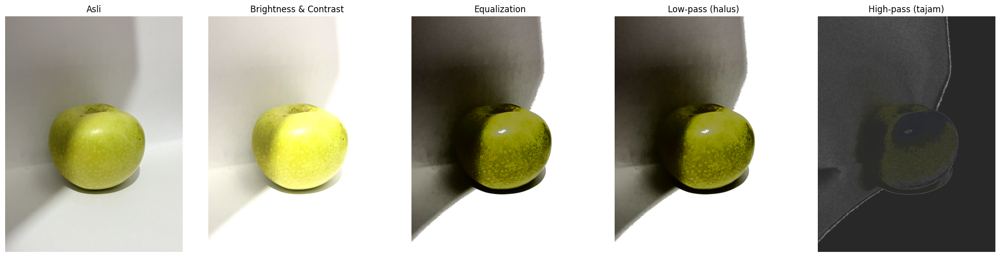

Memproses  Apel Pink Gelap.jpg...


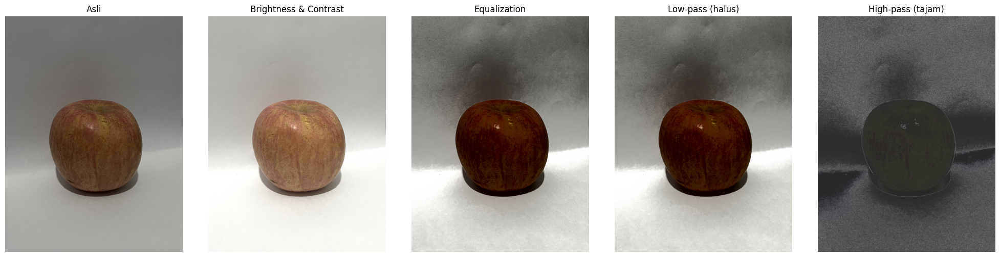

Memproses Apel Hijau Gelap.jpg...


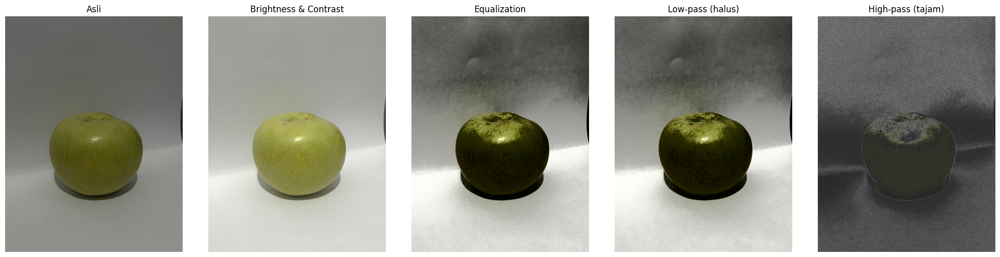

Memproses  Apel Merah Gelap.jpg...


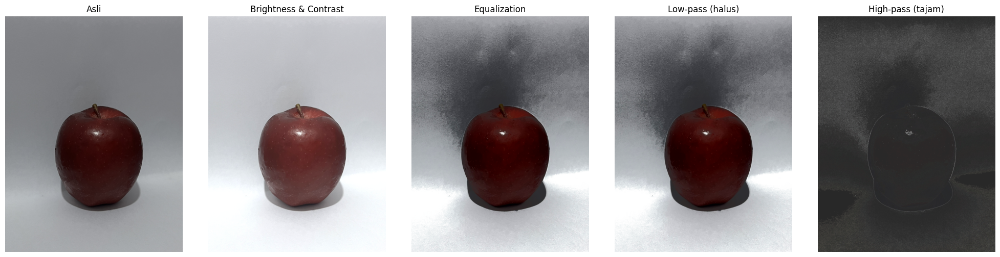

Memproses  Apel Hijau Terang.jpg...


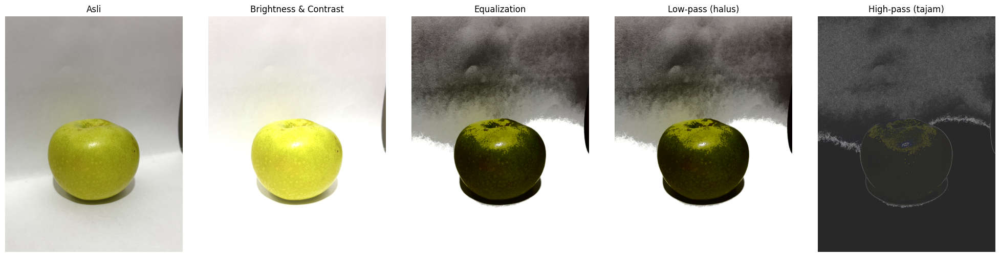

Memproses Apel Pink Berbayang.jpg...


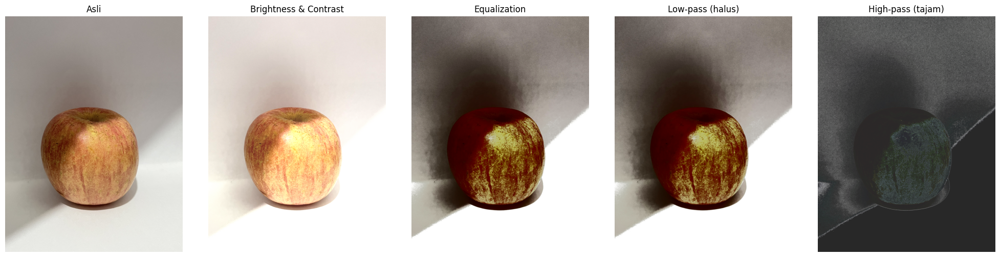

Memproses Apel Merah Terang.jpg...


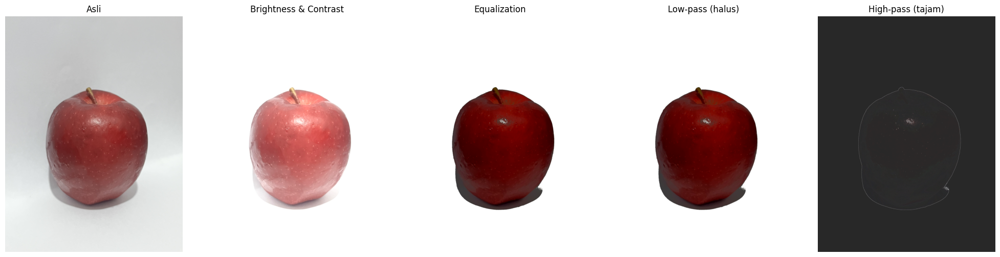

Memproses  Apel Pink Terang.jpg...


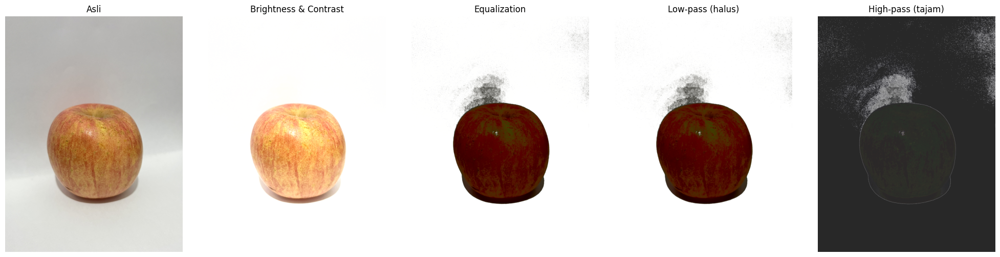

Memproses Apel Merah Berbayang.jpg...


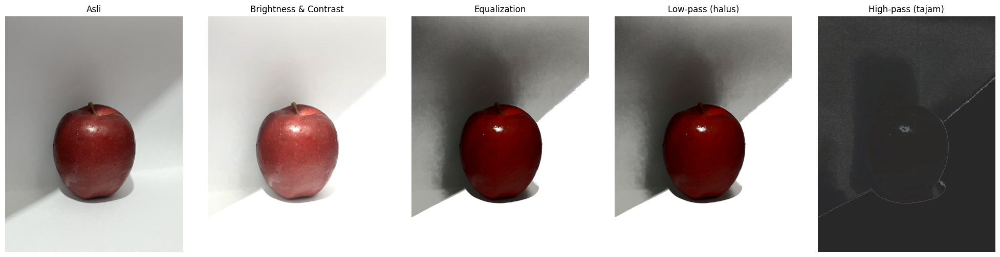

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

folder_path = '/content/drive/MyDrive/POLINEMA/PCVK_Kelompok'

# --- Fungsi Brightness & Contrast ---
def adjust_brightness_contrast(image, alpha, beta):
    return cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

# --- Fungsi Histogram Equalization (RGB) ---
def hist_equalization_rgb(img_rgb):
    img_ycrcb = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2YCrCb)
    y, cr, cb = cv2.split(img_ycrcb)
    y_eq = cv2.equalizeHist(y)
    img_ycrcb_eq = cv2.merge([y_eq, cr, cb])
    return cv2.cvtColor(img_ycrcb_eq, cv2.COLOR_YCrCb2RGB)

# --- Fungsi utama untuk memproses gambar ---
def process_image(image_path, alpha=1.3, beta=30):
    # 1️⃣ Baca gambar RGB
    img_bgr = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

    # 2️⃣ Brightness & Contrast
    img_bc = adjust_brightness_contrast(img_rgb, alpha, beta)

    # 3️⃣ Histogram Equalization
    img_he = hist_equalization_rgb(img_bc)

    # 4️⃣ Low-pass Filter (menghaluskan noise)
    kernel_lp = np.ones((5,5), np.float32)/25   # rata-rata 5x5
    img_lp = cv2.filter2D(img_he, -1, kernel_lp)

    # 5️⃣ High-pass / Laplacian Filter (menajamkan tepi)
    kernel_hp = np.array([[-1,-1,-1],
                          [-1, 8,-1],
                          [-1,-1,-1]])
    img_hp = cv2.filter2D(img_he, -1, kernel_hp)

    # 🔧 Normalisasi hasil high-pass agar tidak gelap
    img_hp_norm = cv2.normalize(img_hp, None, 0, 255, cv2.NORM_MINMAX)
    img_hp_bright = cv2.convertScaleAbs(img_hp_norm, alpha=1.2, beta=40)

    # --- Visualisasi hasil lengkap ---
    fig, axes = plt.subplots(1, 5, figsize=(20,5))
    titles = ['Asli', 'Brightness & Contrast', 'Equalization', 'Low-pass (halus)', 'High-pass (tajam)']
    images = [img_rgb, img_bc, img_he, img_lp, img_hp_bright]

    for ax, img, title in zip(axes, images, titles):
        ax.imshow(img)
        ax.set_title(title)
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# --- Jalankan untuk semua gambar di folder ---
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg','.jpeg','.png'))]

for file in image_files:
    print(f"Memproses {file}...")
    process_image(os.path.join(folder_path, file))


## **5. Implementasikan Floyd–Steinberg Dithering untuk menurunkan kedalaman warna (bit-depth 4–6 bit), lalu analisis bagaimana efeknya terhadap detail.**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
folder_path = "/content/drive/MyDrive/Semester 7/Pengolahan Citra dan Visi Komputer/Week7/"

# Mengambil Semua File Gambar
image_files = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith(('.jpg','.jpeg','.png'))]
image_files.sort()
image_files

['/content/drive/MyDrive/Semester 7/Pengolahan Citra dan Visi Komputer/Week7/Apel Hijau Berbayang.jpg',
 '/content/drive/MyDrive/Semester 7/Pengolahan Citra dan Visi Komputer/Week7/Apel Hijau Gelap.jpg',
 '/content/drive/MyDrive/Semester 7/Pengolahan Citra dan Visi Komputer/Week7/Apel Hijau Terang.jpg',
 '/content/drive/MyDrive/Semester 7/Pengolahan Citra dan Visi Komputer/Week7/Apel Merah Berbayang.jpg',
 '/content/drive/MyDrive/Semester 7/Pengolahan Citra dan Visi Komputer/Week7/Apel Merah Gelap.jpg',
 '/content/drive/MyDrive/Semester 7/Pengolahan Citra dan Visi Komputer/Week7/Apel Merah Terang.jpg',
 '/content/drive/MyDrive/Semester 7/Pengolahan Citra dan Visi Komputer/Week7/Apel Pink Berbayang.jpg',
 '/content/drive/MyDrive/Semester 7/Pengolahan Citra dan Visi Komputer/Week7/Apel Pink Gelap.jpg',
 '/content/drive/MyDrive/Semester 7/Pengolahan Citra dan Visi Komputer/Week7/Apel Pink Terang.jpg']

In [ ]:
def floyd_steinberg_dithering(image, bit_depth=4):
    if len(image.shape) == 3:
        img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    else:
        img = image.copy()

    img = img.astype(np.float32)
    max_val = 2 ** bit_depth - 1

    for y in range(img.shape[0] - 1):
        for x in range(1, img.shape[1] - 1):
            old_pixel = img[y, x]
            new_pixel = np.round((old_pixel / 255) * max_val) * (255 / max_val)
            img[y, x] = new_pixel
            error = old_pixel - new_pixel

            # Penyebaran Error Ke Tetangga (Floyd–Steinberg kernel)
            img[y, x + 1] += error * 7 / 16
            img[y + 1, x - 1] += error * 3 / 16
            img[y + 1, x] += error * 5 / 16
            img[y + 1, x + 1] += error * 1 / 16

    img = np.clip(img, 0, 255)
    return img.astype(np.uint8)

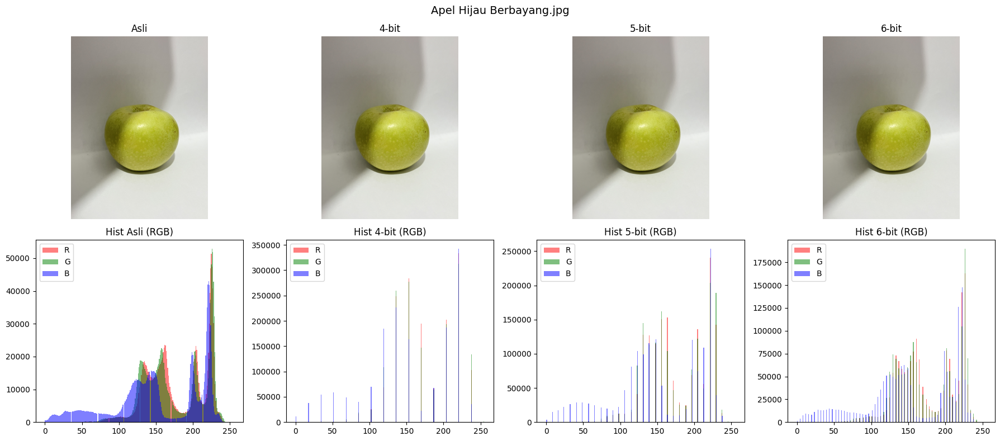

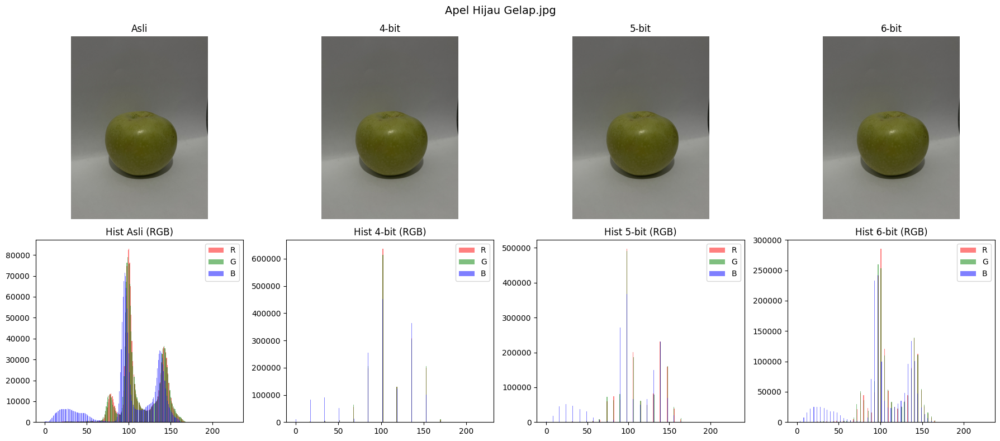

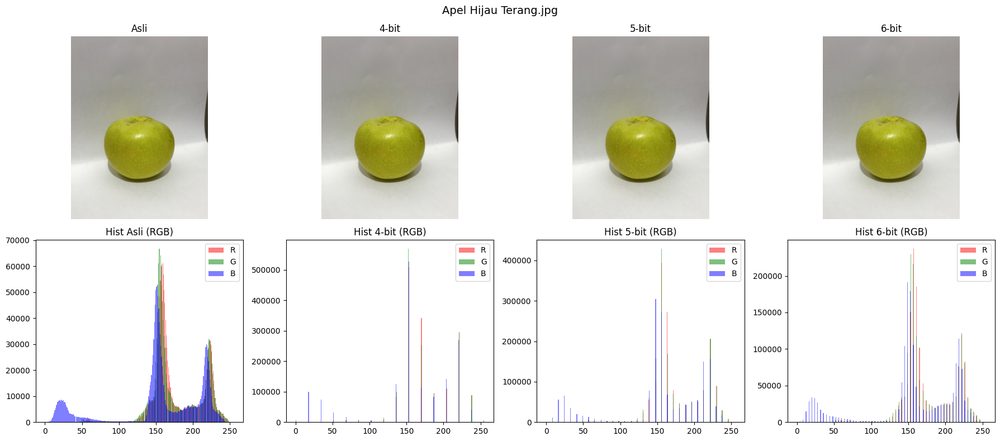

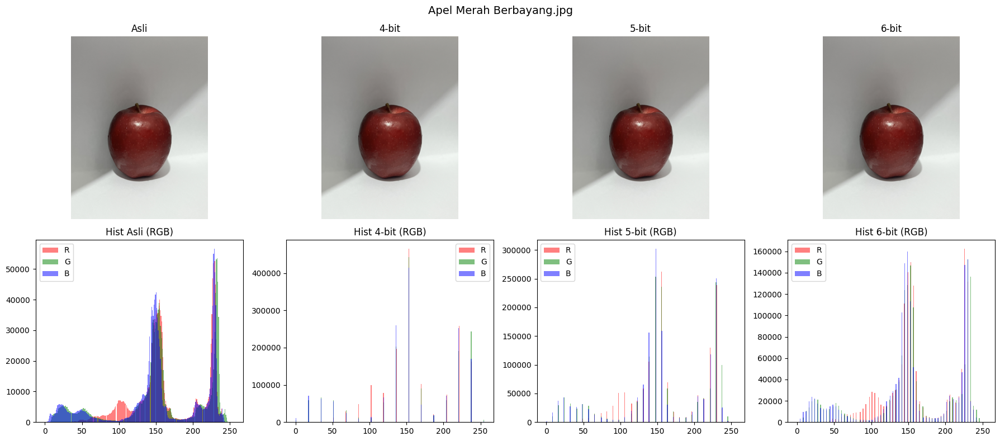

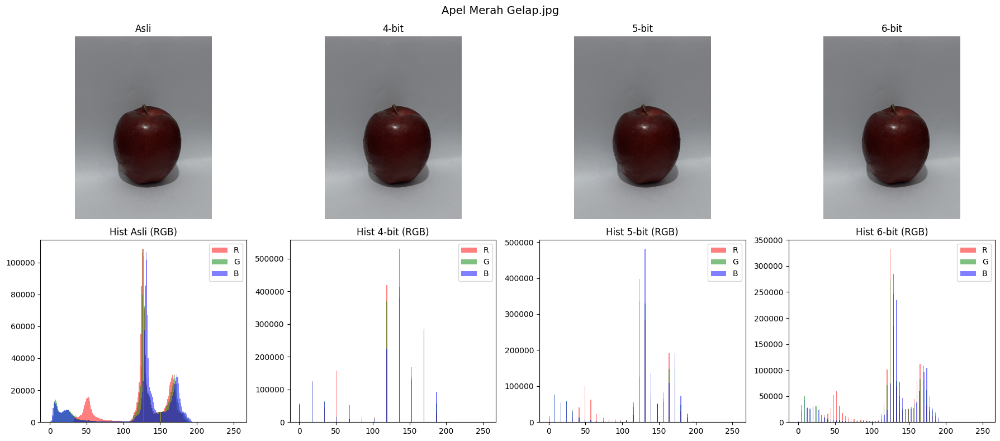

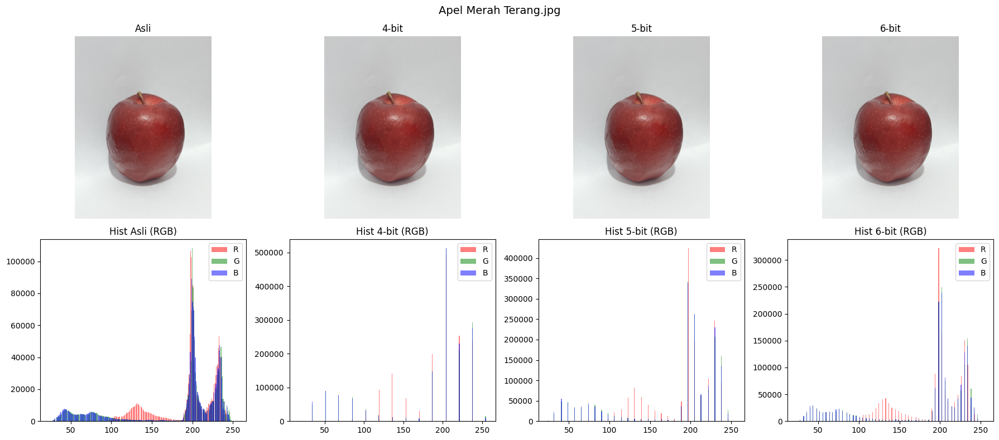

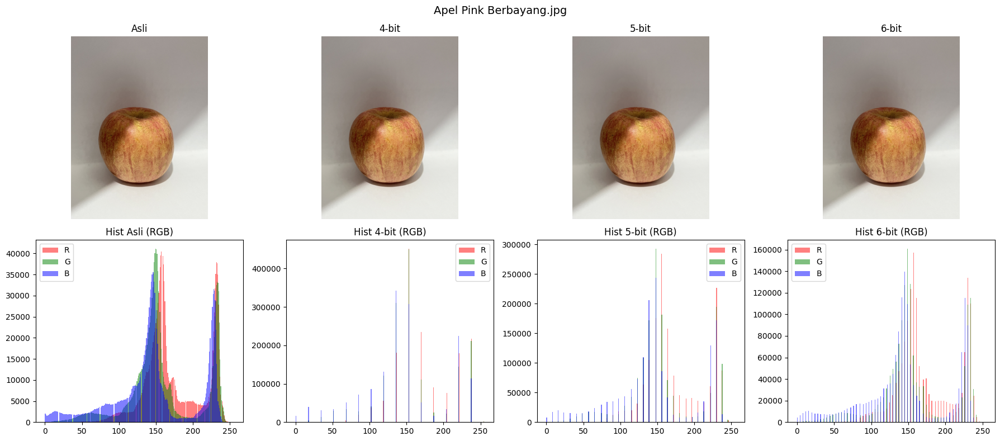

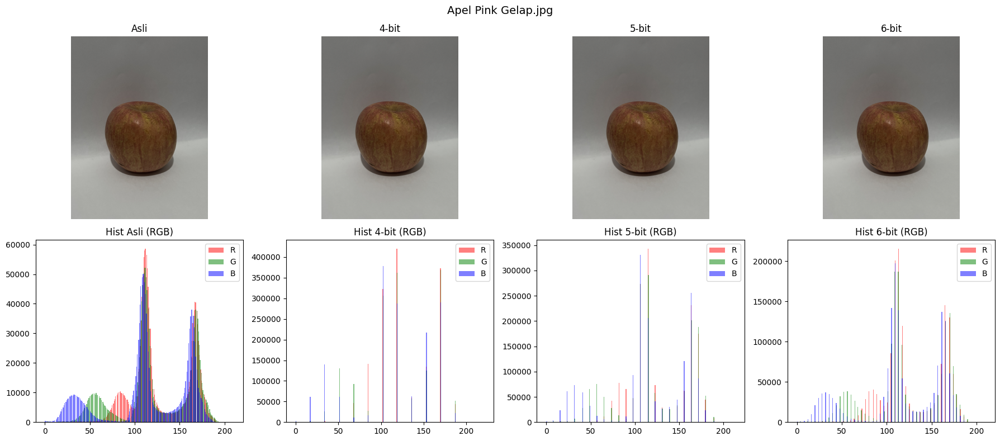

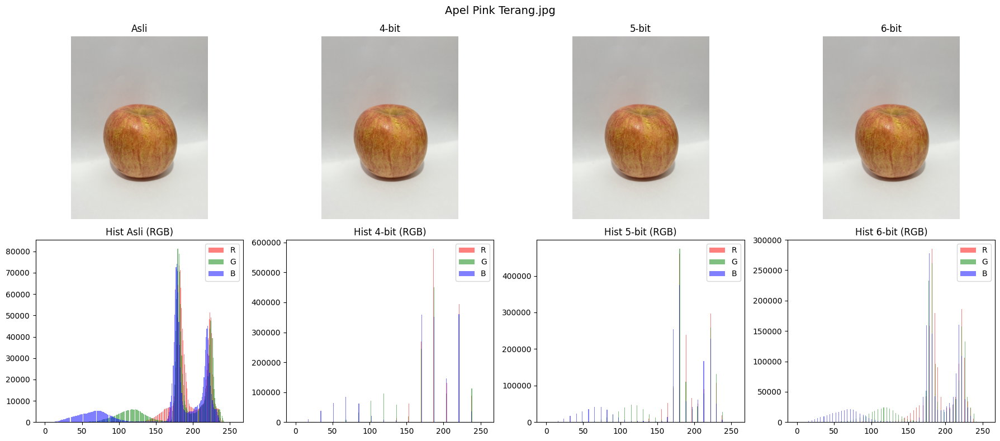

In [ ]:
# Memproses Semua Gambar Apel Dengan Berbagai Bit-Depth + Histogram (Versi RGB, tanpa Equalization)

bit_depths = [4, 5, 6]

for path in image_files:
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (1080, 1440))

    plt.figure(figsize=(18,8))

    # Gambar Asli
    plt.subplot(2, len(bit_depths)+1, 1)
    plt.imshow(img)
    plt.title("Asli")
    plt.axis("off")

    # Histogram gambar asli (RGB)
    plt.subplot(2, len(bit_depths)+1, len(bit_depths)+2)
    plt.hist(img[...,0].ravel(), bins=256, color='r', alpha=0.5, label='R')
    plt.hist(img[...,1].ravel(), bins=256, color='g', alpha=0.5, label='G')
    plt.hist(img[...,2].ravel(), bins=256, color='b', alpha=0.5, label='B')
    plt.title("Hist Asli (RGB)")
    plt.legend()

    # Hasil Floyd–Steinberg Dithering per channel
    for i, bit in enumerate(bit_depths):
        dithered = np.zeros_like(img)
        for c in range(3):  # Proses R, G, B secara terpisah
            dithered[..., c] = floyd_steinberg_dithering(img[..., c], bit)

        # Hasil dithering
        plt.subplot(2, len(bit_depths)+1, i+2)
        plt.imshow(dithered)
        plt.title(f'{bit}-bit')
        plt.axis("off")

        # Histogram hasil dithering (RGB)
        plt.subplot(2, len(bit_depths)+1, len(bit_depths)+3+i)
        plt.hist(dithered[...,0].ravel(), bins=256, color='r', alpha=0.5, label='R')
        plt.hist(dithered[...,1].ravel(), bins=256, color='g', alpha=0.5, label='G')
        plt.hist(dithered[...,2].ravel(), bins=256, color='b', alpha=0.5, label='B')
        plt.title(f'Hist {bit}-bit (RGB)')
        plt.legend()

    plt.suptitle(os.path.basename(path), fontsize=14)
    plt.tight_layout()
    plt.show()

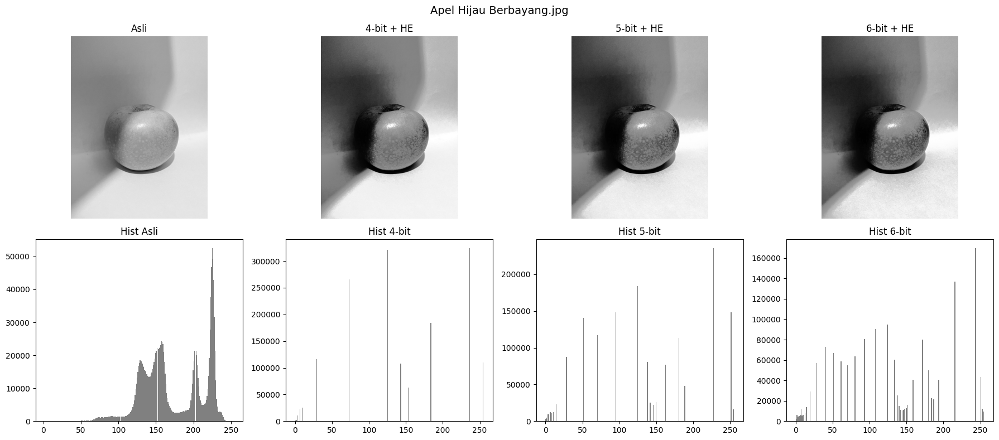

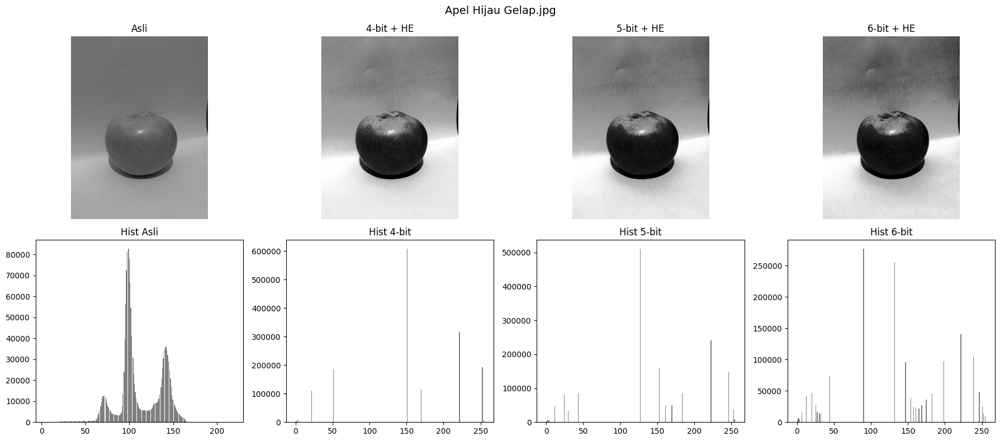

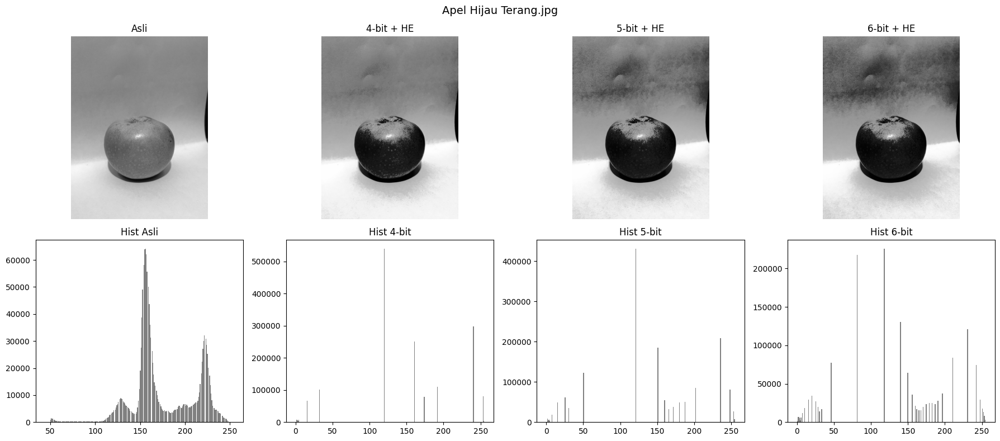

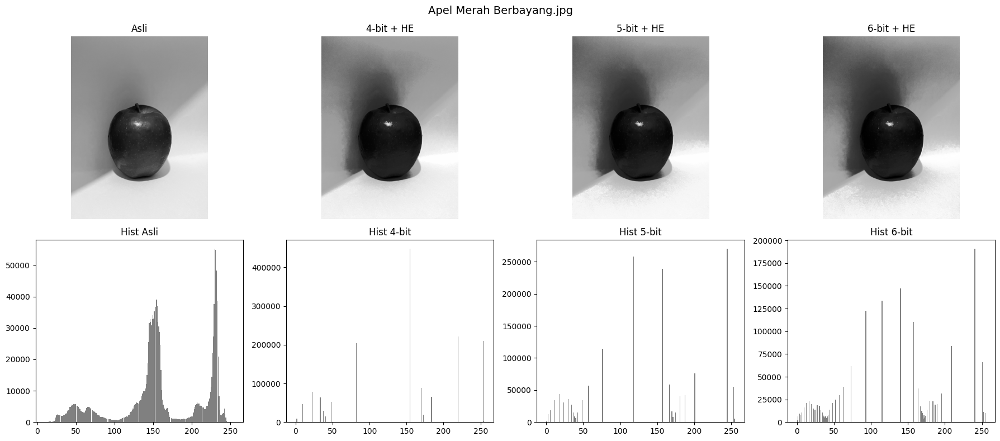

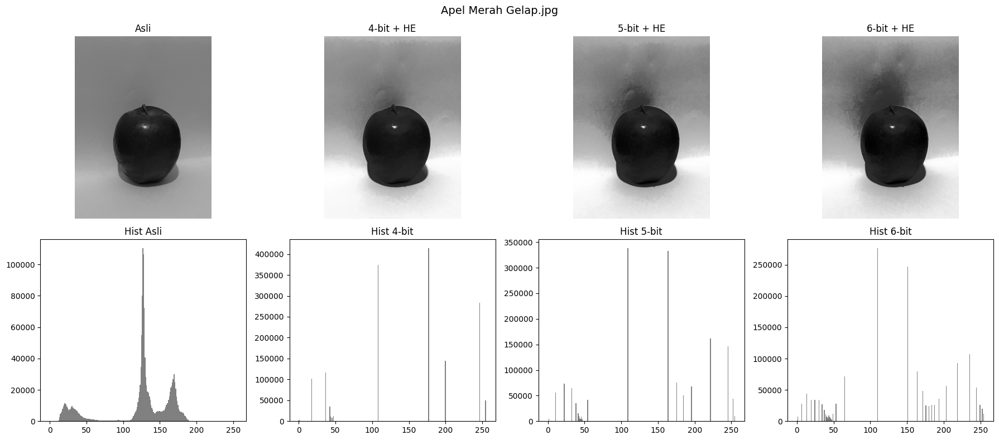

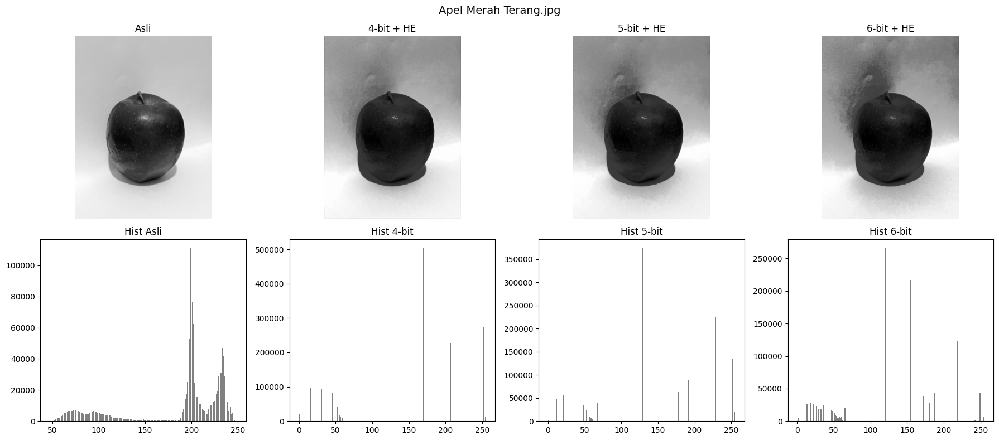

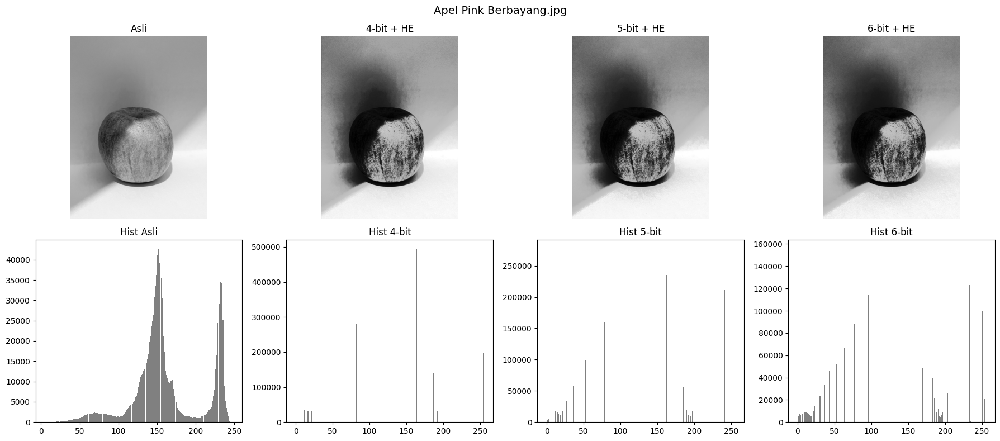

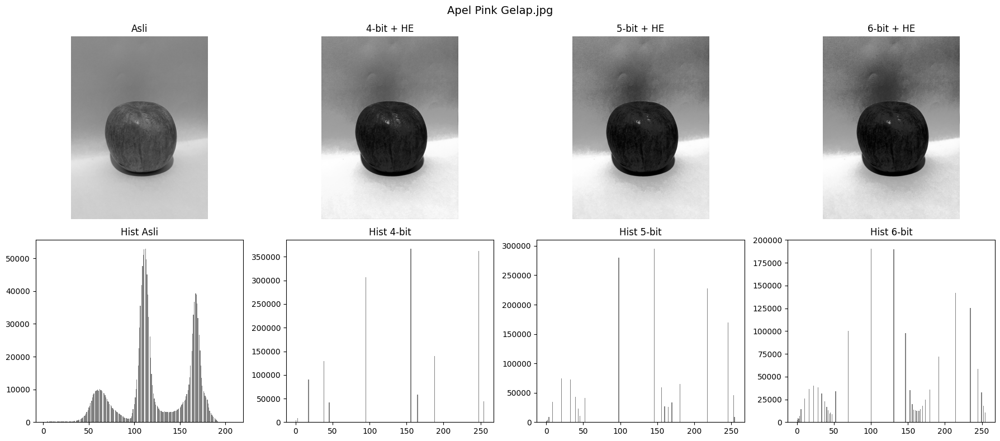

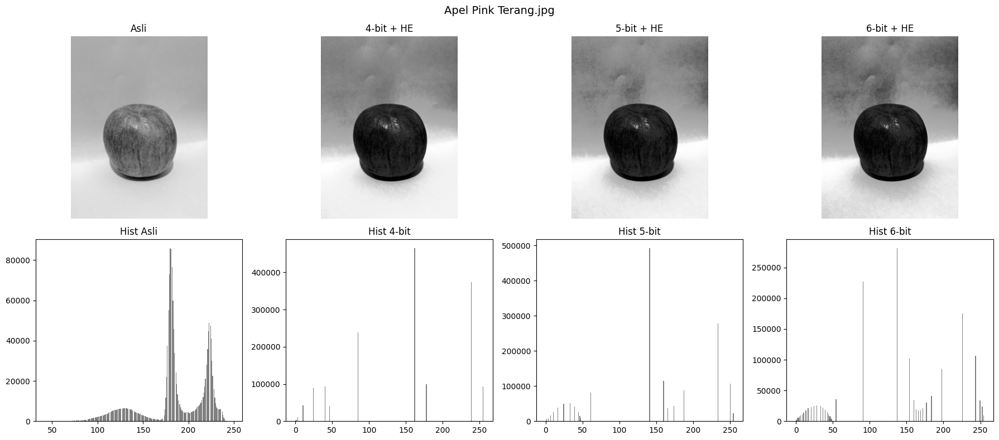

In [ ]:
# Memproses Semua Gambar Apel Dengan Berbagai Bit-Depth + Histogram Equalization

bit_depths = [4, 5, 6]

for path in image_files:
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img = cv2.resize(img, (1080, 1440))

    plt.figure(figsize=(18,8))

    # Gambar Asli
    plt.subplot(2, len(bit_depths)+1, 1)
    plt.imshow(img, cmap='gray')
    plt.title("Asli")
    plt.axis("off")

    # Histogram gambar asli
    plt.subplot(2, len(bit_depths)+1, len(bit_depths)+2)
    plt.hist(img.ravel(), bins=256, color='gray')
    plt.title("Hist Asli")

    # Hasil Floyd-Steinberg Dithering
    for i, bit in enumerate(bit_depths):
        dithered = floyd_steinberg_dithering(img, bit)

        # Histogram Equalization
        equalized = cv2.equalizeHist(dithered)

        # Hasil dithering
        plt.subplot(2, len(bit_depths)+1, i+2)
        plt.imshow(equalized, cmap='gray')
        plt.title(f'{bit}-bit + HE')
        plt.axis("off")

        # Histogram setelah equalization
        plt.subplot(2, len(bit_depths)+1, len(bit_depths)+3+i)
        plt.hist(equalized.ravel(), bins=256, color='gray')
        plt.title(f'Hist {bit}-bit')

    plt.suptitle(os.path.basename(path), fontsize=14)
    plt.tight_layout()
    plt.show()

Floyd Steinberg dithering membantu mempertahankan persepsi visual meskipun jumlah warna dikurangi. Namun semakin rendah bit-depth, semakin banyak detail halus yang hilang.

# **Bagian C – Implementasi (Python–OpenCV)**

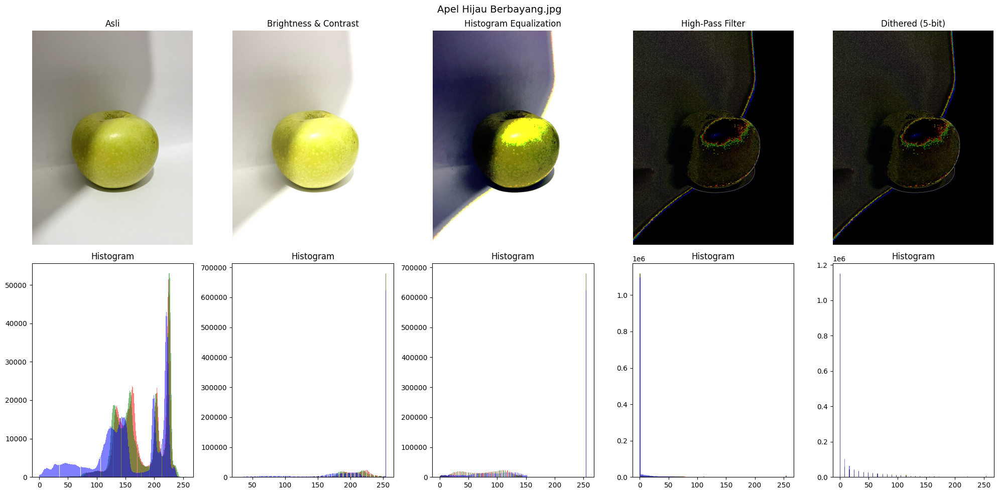

Apel Hijau Berbayang.jpg (Citra Asli) → Nilai PSNR: inf dB | Bit-Depth: 5-bit
Apel Hijau Berbayang.jpg (Citra Processed) → Nilai PSNR: 3.66 dB | Bit-Depth: 5-bit



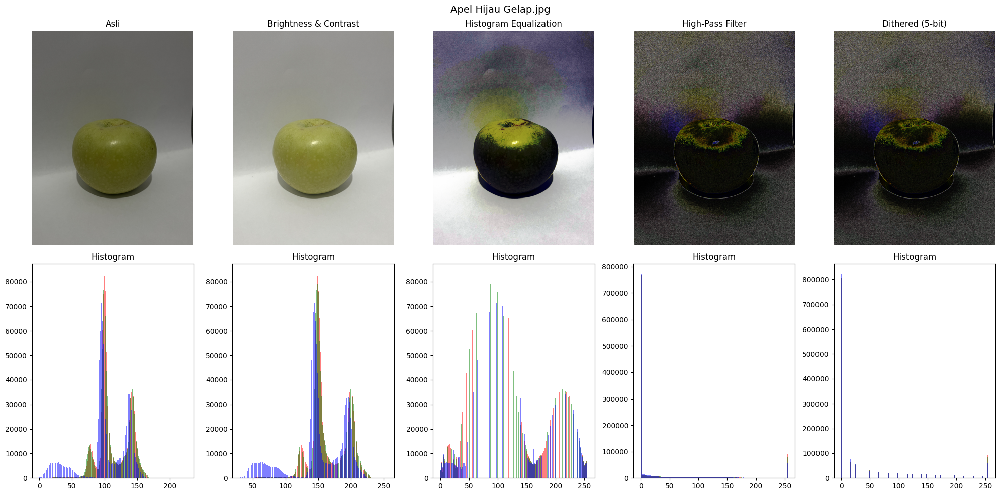

Apel Hijau Gelap.jpg (Citra Asli) → Nilai PSNR: inf dB | Bit-Depth: 5-bit
Apel Hijau Gelap.jpg (Citra Processed) → Nilai PSNR: 8.07 dB | Bit-Depth: 5-bit



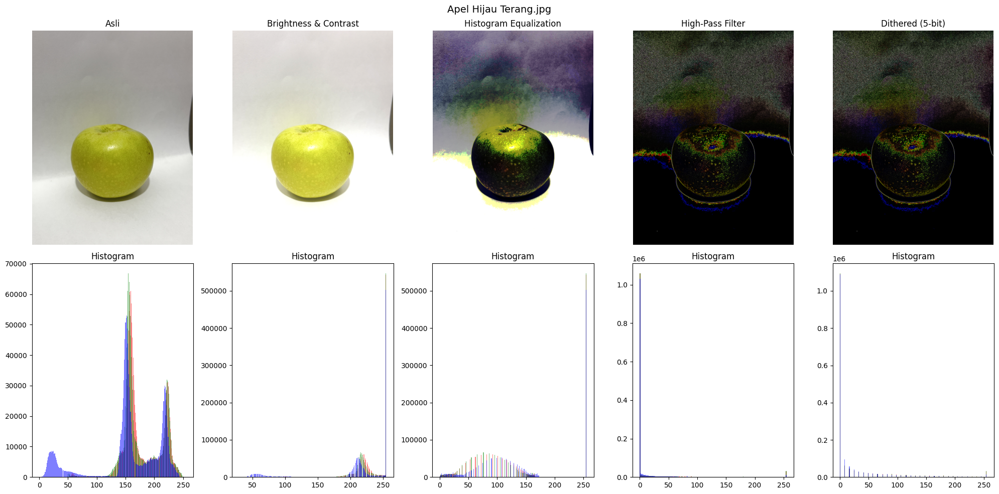

Apel Hijau Terang.jpg (Citra Asli) → Nilai PSNR: inf dB | Bit-Depth: 5-bit
Apel Hijau Terang.jpg (Citra Processed) → Nilai PSNR: 3.82 dB | Bit-Depth: 5-bit



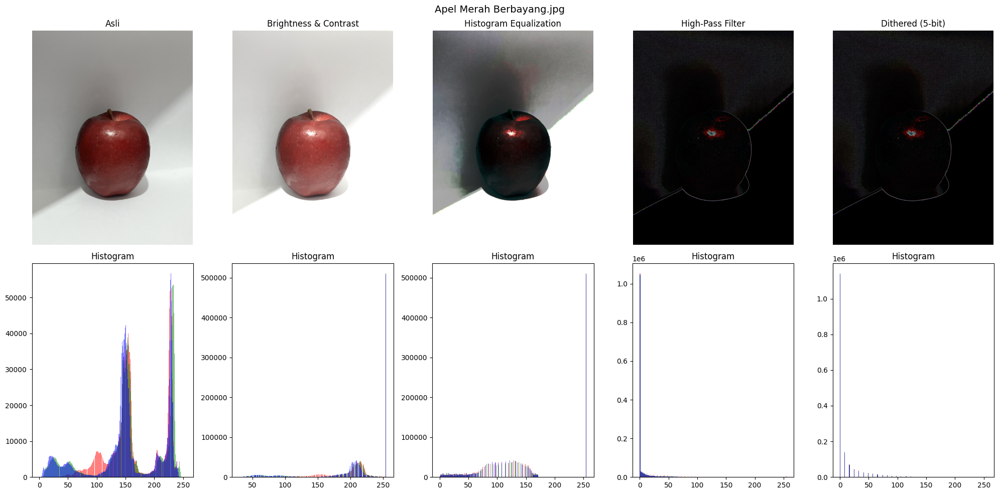

Apel Merah Berbayang.jpg (Citra Asli) → Nilai PSNR: inf dB | Bit-Depth: 5-bit
Apel Merah Berbayang.jpg (Citra Processed) → Nilai PSNR: 3.88 dB | Bit-Depth: 5-bit



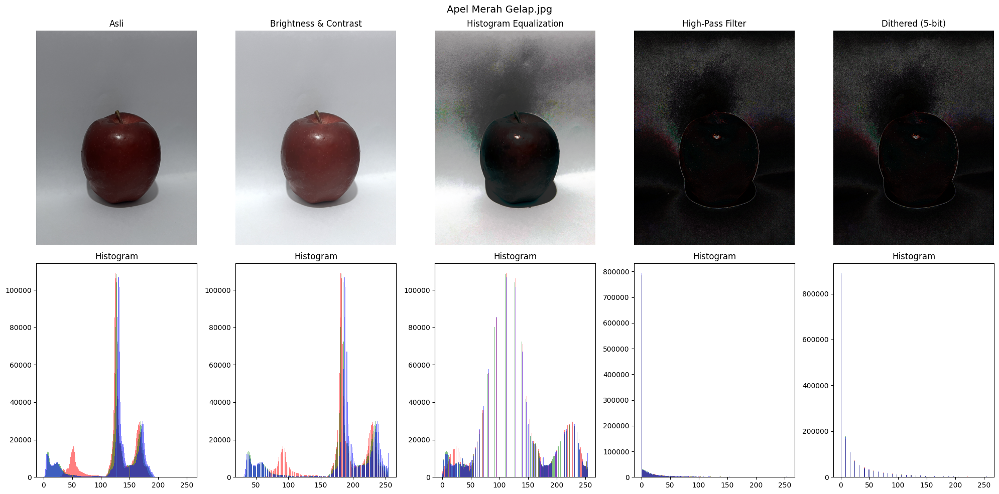

Apel Merah Gelap.jpg (Citra Asli) → Nilai PSNR: inf dB | Bit-Depth: 5-bit
Apel Merah Gelap.jpg (Citra Processed) → Nilai PSNR: 6.62 dB | Bit-Depth: 5-bit



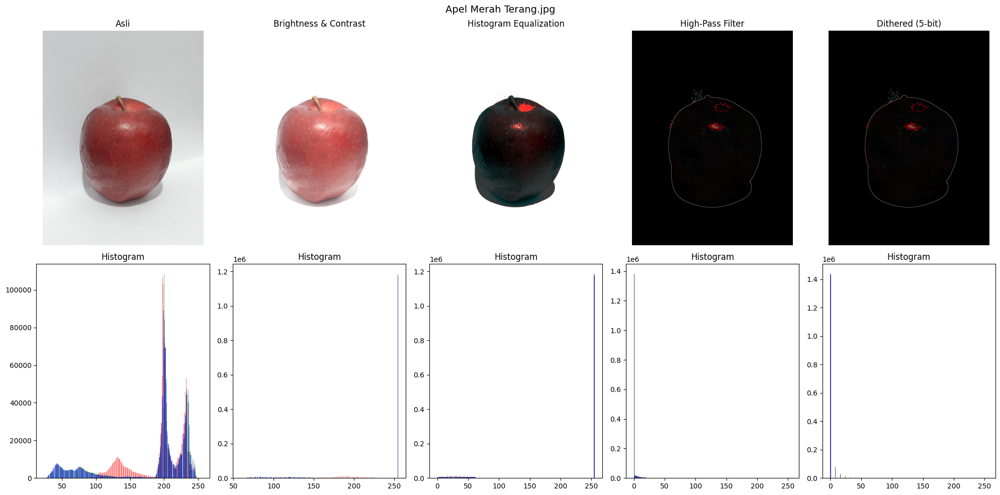

Apel Merah Terang.jpg (Citra Asli) → Nilai PSNR: inf dB | Bit-Depth: 5-bit
Apel Merah Terang.jpg (Citra Processed) → Nilai PSNR: 2.44 dB | Bit-Depth: 5-bit



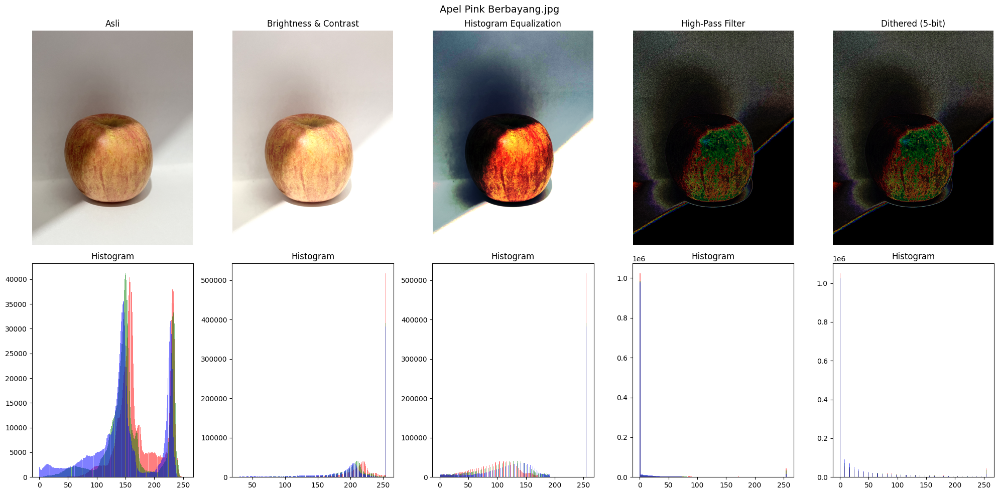

Apel Pink Berbayang.jpg (Citra Asli) → Nilai PSNR: inf dB | Bit-Depth: 5-bit
Apel Pink Berbayang.jpg (Citra Processed) → Nilai PSNR: 4.37 dB | Bit-Depth: 5-bit



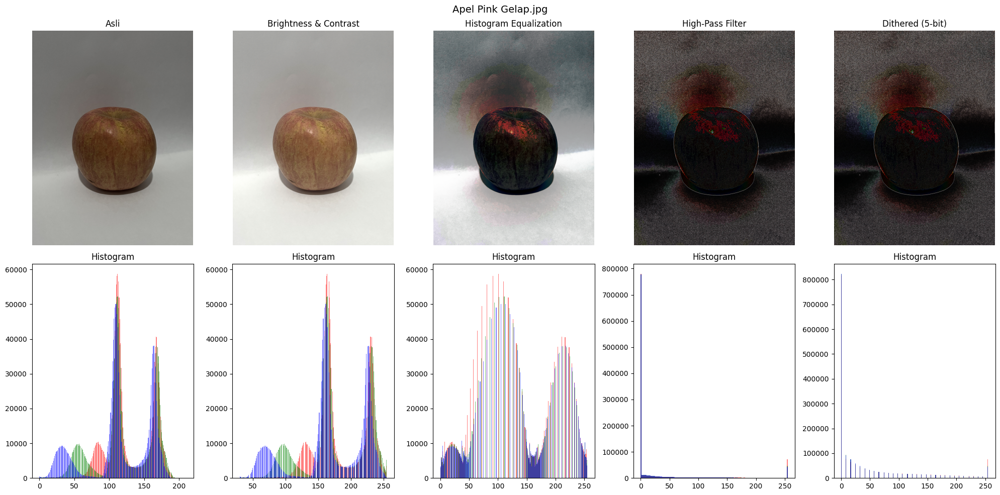

Apel Pink Gelap.jpg (Citra Asli) → Nilai PSNR: inf dB | Bit-Depth: 5-bit
Apel Pink Gelap.jpg (Citra Processed) → Nilai PSNR: 7.28 dB | Bit-Depth: 5-bit



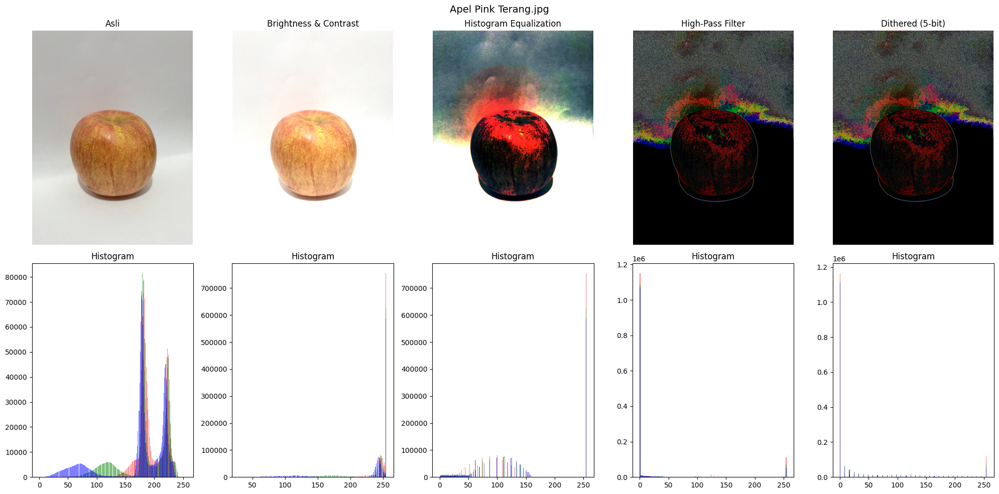

Apel Pink Terang.jpg (Citra Asli) → Nilai PSNR: inf dB | Bit-Depth: 5-bit
Apel Pink Terang.jpg (Citra Processed) → Nilai PSNR: 3.41 dB | Bit-Depth: 5-bit



In [ ]:
# =============================================================
# Bagian A - Observasi & Eksperimen
# Floyd–Steinberg Dithering + Analisis PSNR (Tanpa Referensi)
# =============================================================

import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Folder tempat semua gambar apel
Cfolder_path = "/content/drive/MyDrive/Semester 7/Pengolahan Citra dan Visi Komputer/Week7/"

# Ambil semua file gambar
image_files = [os.path.join(Cfolder_path, f) for f in os.listdir(Cfolder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]
image_files.sort()

# =============================================================
# FUNGSI UTAMA
# =============================================================

def floyd_steinberg_dithering(img, bit_depth=4):
    """Implementasi Floyd–Steinberg Dithering"""
    img = img.astype(float)
    levels = 2 ** bit_depth
    h, w, c = img.shape if len(img.shape) == 3 else (*img.shape, 1)

    for y in range(h):
        for x in range(w):
            old_pixel = img[y, x]
            new_pixel = np.round(old_pixel * (levels - 1) / 255) * (255 / (levels - 1))
            img[y, x] = new_pixel
            error = old_pixel - new_pixel

            if x + 1 < w:
                img[y, x+1] += error * 7/16
            if y + 1 < h and x > 0:
                img[y+1, x-1] += error * 3/16
            if y + 1 < h:
                img[y+1, x] += error * 5/16
            if y + 1 < h and x + 1 < w:
                img[y+1, x+1] += error * 1/16

    return np.clip(img, 0, 255).astype(np.uint8)


def psnr(img1, img2):
    """Menghitung Peak Signal-to-Noise Ratio (PSNR)"""
    mse = np.mean((img1.astype(np.float64) - img2.astype(np.float64)) ** 2)
    if mse == 0:
        return float('inf')
    PIXEL_MAX = 255.0
    return 20 * np.log10(PIXEL_MAX / np.sqrt(mse))


# =============================================================
# PROSES GAMBAR
# =============================================================

bit_depth = 5  # ubah sesuai kebutuhan

for path in image_files:
    # Baca dan resize ke 1080x1440
    img = cv2.imread(path, cv2.IMREAD_COLOR)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (1080, 1440))

    # --- Brightness & Contrast ---
    b, a = 30, 1.2
    img_bc = cv2.convertScaleAbs(img, alpha=a, beta=b)

    # --- Histogram Equalization ---
    img_he = np.zeros_like(img_bc)
    for c in range(3):
        img_he[..., c] = cv2.equalizeHist(img_bc[..., c])

    # --- High Pass Filter ---
    kernel_hp = np.array([[-1, -1, -1],
                          [-1,  8, -1],
                          [-1, -1, -1]])
    img_hp = cv2.filter2D(img_he, -1, kernel_hp)

    # --- Floyd–Steinberg Dithering ---
    dithered = np.zeros_like(img_hp)
    for c in range(3):
        dithered[..., c] = floyd_steinberg_dithering(img_hp[..., c], bit_depth)

    # =============================================================
    # VISUALISASI
    # =============================================================
    plt.figure(figsize=(20,10))
    stages = [img, img_bc, img_he, img_hp, dithered]
    titles = ["Asli", "Brightness & Contrast", "Histogram Equalization", "High-Pass Filter", f"Dithered ({bit_depth}-bit)"]

    for i, (im, title) in enumerate(zip(stages, titles)):
        plt.subplot(2, len(stages), i+1)
        plt.imshow(im)
        plt.title(title)
        plt.axis("off")

        # Histogram RGB
        plt.subplot(2, len(stages), len(stages) + i + 1)
        plt.hist(im[...,0].ravel(), bins=256, color='r', alpha=0.5)
        plt.hist(im[...,1].ravel(), bins=256, color='g', alpha=0.5)
        plt.hist(im[...,2].ravel(), bins=256, color='b', alpha=0.5)
        plt.title("Histogram")

    plt.suptitle(os.path.basename(path), fontsize=14)
    plt.tight_layout()
    plt.show()

    # =============================================================
    # HITUNG DAN CETAK PSNR
    # =============================================================
    psnr_asli = psnr(img, img)
    psnr_processed = psnr(img, dithered)

    print(f"{os.path.basename(path)} (Citra Asli) → Nilai PSNR: {psnr_asli:.2f} dB | Bit-Depth: {bit_depth}-bit")
    print(f"{os.path.basename(path)} (Citra Processed) → Nilai PSNR: {psnr_processed:.2f} dB | Bit-Depth: {bit_depth}-bit\n")

# **Bagian D – Analisis Akhir & Kesimpulan**

## **1. Urutan proses terbaik untuk menghasilkan citra paling siap recognition**

## **2. Perbandingan nilai PSNR antara citra asli yang memiliki pencahayaan baik dan hasil pra-pemrosesan**